# Image Classification using Deep Networks


## Models:
#### 1. VGG16
#### 2. GoogLeNet
#### 3. ResNet


All the experiments were recorded using tensorboard. I have published them and can be accessed using this link:
https://tensorboard.dev/experiment/DXd6XeJNSQmc60oOzcPm5g

# Introduction

Image classification is a challenging task, only recently researcher started employing deep leaning and CNN in such task. The fact that neural networks have done an incredible job in detecting and learning details from images has changed the world.
This project has examined three famous deep networks: VGG, GoogLeNet and ResNet, and modified them to classify three datasets: MNIST, Fashion MNIST and CIFAR10.
For VGG, batch normalization layers were added.
For GoogLeNet and ResNet, the original networks were fine-tuned to suit the datasets more properly by reducing the dimensionality, then modifying the internal architecture. GoogLeNet were made of 18 layers instead of 22. While ResNet was made wider.

The modified networks achieved better accuracies on CIFAR10 (the most complex amongst the datasets). The comparisons were recorded using tensorboard.

In [ ]:
import os
import io
import time
import itertools
from datetime import datetime
from typing import Dict
from google.colab import drive

import numpy as np
import torch
import random
import tensorflow as tf
from matplotlib import pyplot as plt, gridspec
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
from torch import optim, nn
import torch.nn.functional as F
from torchsummary import summary 
from torch.optim import lr_scheduler
from torch.utils.data import DataLoader
from torch.utils.tensorboard import SummaryWriter
from torchvision import datasets, models
from torchvision.transforms import transforms
from torchvision.models.vgg import make_layers
from tqdm import tqdm

# Load the TensorBoard notebook extension
%load_ext tensorboard

drive.mount('/content/drive')

In [7]:
# create folders in drive for data and results if not created
ROOT_PATH = "/content/drive/MyDrive/CW3"
DATA_DIR = f'{ROOT_PATH}/data'
SAVE_DIR = f'{ROOT_PATH}/results'

if not os.path.exists(DATA_DIR):
    !mkdir /content/drive/MyDrive/CW3/data
if not os.path.exists(SAVE_DIR):
    !mkdir /content/drive/MyDrive/CW3/results

In [10]:
MODELS = ['vgg16_bn', 'resnet', 'google_net']
DATASETS = ['mnist', 'fmnist', 'cifar10']
OPTIMIZERS = ['SGD', 'Adam']
LEARNING_RATES = [0.01, 0.001, 0.0001]
BATCH_SIZES = [16, 32, 64]
TRAIN = 'train'
VALIDATION = 'val'
TEST = 'test'

In [28]:
# set the seed
def set_seed(seed):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed(seed)
        torch.cuda.manual_seed_all(seed)
set_seed(42)

# Ensure that all operations are deterministic on GPU for reproducibility
torch.backends.cudnn.determinstic = True
torch.backends.cudnn.benchmark = False

## **VGG16 with Batch Normalization  Model**

The original model takes an input of size 224x244, the spatial size is not restricted to this one, any size more than 32 is applicable, due to the adaptive pooling layers.
Training a deep neural network is a difficult task and takes a long time to converge. An effective technique to accelerate the convergence consistently is batch normalization.
The most important feature of the customized network is that it uses batch normalization, which hadn't been introduced yet back at the time when VGG was invented. The batch normalization is done with each training iteration, the inputs are normalized using the mean and standard deviation estimated based on the statistics of the current minibatch. Then a scale coefficient and a scale offset are applied. This helps in reducing internal covariate shift and as a result, we control better the overfitting problem, increase accuracy and improve training speed.
The network consists of 5 convolutional blocks just like the original, however, the block sequence has an extra batch normalization layer.

A block could be structured of a number of the following sequence:
1. A convolutional layer with a kernel size of 3, padding of 1 and a stride of 1
2. Batch normalization layer
3. ReLU activation function
4. Max pooling layer with stride of 2

In [4]:
def vgg16_bn(pretrained=False, num_classes=10):
    return models.vgg16_bn(pretrained=pretrained, num_classes=num_classes)

print('VGG16_bn Architecture:')
summary(vgg16_bn(num_classes=10).cuda(), (3, 64, 64))

VGG16_bn Architecture:
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 64, 64]           1,792
       BatchNorm2d-2           [-1, 64, 64, 64]             128
              ReLU-3           [-1, 64, 64, 64]               0
            Conv2d-4           [-1, 64, 64, 64]          36,928
       BatchNorm2d-5           [-1, 64, 64, 64]             128
              ReLU-6           [-1, 64, 64, 64]               0
         MaxPool2d-7           [-1, 64, 32, 32]               0
            Conv2d-8          [-1, 128, 32, 32]          73,856
       BatchNorm2d-9          [-1, 128, 32, 32]             256
             ReLU-10          [-1, 128, 32, 32]               0
           Conv2d-11          [-1, 128, 32, 32]         147,584
      BatchNorm2d-12          [-1, 128, 32, 32]             256
             ReLU-13          [-1, 128, 32, 32]               0
        MaxPool2

## **GoogLeNet Model**

The original GoogleNet architecture was designed for images of size 3x224x224 to classify 1000 classes. Since our task is simpler than that, some modifications were applied to the network to meet our needs.
The modified GoogLeNet is 18-layers deep, it will take a 3x32x32 image and classify it into 10 classes. In the beginning, the three convolutional layers 7x7, 1x1 and 3x3 were replaced with one 3x3 convolutional layer, that outputs 46 channels, and it is connected directly to the inception modules without max pooling layer. Following this layer, a chain of eight inception modules instead of nine. An inception module contains four convolution blocks which applied separately on the same feature map, allowing the network to extract the same data with different receptive fields. The convolution blocks are 1x1, 3x3x, 5x5 convolution layers and a max pooling layer. Like the original inception modules, the second and third blocks are preceded with a 1x1 convolutional layer to reduce dimensionality, so that we could merge all the branches afterwards. Two max pooling layers are placed after the first two inception modules and before the last two as well to reduce the height and width of feature maps. The output of the last inception module is connected to an average pooling layer which is carried out to a fully connected layer that inputs 128 channels and outputs 10 class, removing the dropout layer in between, since this model is already a reduced version of the original, however, each convolutional layer is followed by batch normalization layer and a ReLU activation function, the batch normalization helps in regularizing the model and better at generalizations.

In [5]:
class InceptionModule(nn.Module):

    def __init__(self, c_in, c_reduce: dict, c_out: dict):
        """
        Create an inception block
        :param c_in: input feature number
        :param c_reduce: dictionary with keys "3x3" and "5x5" specifying the output of the dimensionality reducing 1x1 convolutions
        :param c_out: dictionary with keys "1x1", "3x3", "5x5", and "max"
        """
        super().__init__()

        # 1x1 convolution branch
        self.conv_1x1 = nn.Sequential(
            nn.Conv2d(c_in, c_out["1x1"], kernel_size=1),
            nn.BatchNorm2d(c_out["1x1"]),
            nn.ReLU()
        )
        # 3x3 convolution branch
        self.conv_3x3 = nn.Sequential(
            nn.Conv2d(c_in, c_reduce["3x3"], kernel_size=1),
            nn.BatchNorm2d(c_reduce["3x3"]),
            nn.ReLU(),
            nn.Conv2d(c_reduce["3x3"], c_out["3x3"], kernel_size=3, padding=1),
            nn.BatchNorm2d(c_out["3x3"]),
            nn.ReLU()
        )
        # 5x5 convolution branch
        self.conv_5x5 = nn.Sequential(
            nn.Conv2d(c_in, c_reduce["5x5"], kernel_size=1),
            nn.BatchNorm2d(c_reduce["5x5"]),
            nn.ReLU(),
            nn.Conv2d(c_reduce["5x5"], c_out["5x5"], kernel_size=5, padding=2),
            nn.BatchNorm2d(c_out["5x5"]),
            nn.ReLU()
        )
        # Max-pool branch
        self.max_pool = nn.Sequential(
            nn.MaxPool2d(kernel_size=3, padding=1, stride=1),
            nn.Conv2d(c_in, c_out["max"], kernel_size=1),
            nn.BatchNorm2d(c_out["max"]),
            nn.ReLU()
        )

    def forward(self, x):
        x_1x1 = self.conv_1x1(x)
        x_3x3 = self.conv_3x3(x)
        x_5x5 = self.conv_5x5(x)
        x_max = self.max_pool(x)
        x_out = torch.cat([x_1x1, x_3x3, x_5x5, x_max], dim=1)
        return x_out


class GoogLeNet(nn.Module):

    def __init__(self, num_classes=10, **kwargs):
        super().__init__()
        self._create_network(num_classes)
        self._init_weights()

    def _create_network(self, num_classes):
        # first convolutional layer, scaling up the channel size
        self.input_layer = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU()
        )
        # stack inception modules
        self.inception_blocks = nn.Sequential(
            InceptionModule(64, c_reduce={"3x3": 32, "5x5": 16}, c_out={"1x1": 16, "3x3": 32, "5x5": 8, "max": 8}),
            InceptionModule(64, c_reduce={"3x3": 32, "5x5": 16}, c_out={"1x1": 24, "3x3": 48, "5x5": 12, "max": 12}),
            nn.MaxPool2d(3, stride=2, padding=1),  # 32x32 => 16x16
            InceptionModule(96, c_reduce={"3x3": 32, "5x5": 16}, c_out={"1x1": 24, "3x3": 48, "5x5": 12, "max": 12}),
            InceptionModule(96, c_reduce={"3x3": 32, "5x5": 16}, c_out={"1x1": 16, "3x3": 48, "5x5": 16, "max": 16}),
            InceptionModule(96, c_reduce={"3x3": 32, "5x5": 16}, c_out={"1x1": 16, "3x3": 48, "5x5": 16, "max": 16}),
            InceptionModule(96, c_reduce={"3x3": 32, "5x5": 16}, c_out={"1x1": 32, "3x3": 48, "5x5": 24, "max": 24}),
            nn.MaxPool2d(3, stride=2, padding=1),  # 16x16 => 8x8
            InceptionModule(128, c_reduce={"3x3": 48, "5x5": 16}, c_out={"1x1": 32, "3x3": 64, "5x5": 16, "max": 16}),
            InceptionModule(128, c_reduce={"3x3": 48, "5x5": 16}, c_out={"1x1": 32, "3x3": 64, "5x5": 16, "max": 16})
        )
        # map to classification output
        self.output_layer = nn.Sequential(
            nn.AdaptiveAvgPool2d((1, 1)),
            nn.Flatten(),
            nn.Linear(128, num_classes)
        )

    def _init_weights(self):
        # initialize the convolutions according to the activation function
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, nonlinearity='relu')
            elif isinstance(m, nn.BatchNorm2d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)

    def forward(self, x):
        x = self.input_layer(x)
        x = self.inception_blocks(x)
        x = self.output_layer(x)
        return x

print('GoogLeNet Architecture:')
summary(GoogLeNet(num_classes=10).cuda(), (3, 32, 32))

GoogLeNet Architecture:
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 32, 32]           1,792
       BatchNorm2d-2           [-1, 64, 32, 32]             128
              ReLU-3           [-1, 64, 32, 32]               0
            Conv2d-4           [-1, 16, 32, 32]           1,040
       BatchNorm2d-5           [-1, 16, 32, 32]              32
              ReLU-6           [-1, 16, 32, 32]               0
            Conv2d-7           [-1, 32, 32, 32]           2,080
       BatchNorm2d-8           [-1, 32, 32, 32]              64
              ReLU-9           [-1, 32, 32, 32]               0
           Conv2d-10           [-1, 32, 32, 32]           9,248
      BatchNorm2d-11           [-1, 32, 32, 32]              64
             ReLU-12           [-1, 32, 32, 32]               0
           Conv2d-13           [-1, 16, 32, 32]           1,040
      BatchNorm

## **ResNet Model**
The modified ResNet network takes an image of size 3x32x32 inputs it into the first layer, and since the dimension decreased compared to the original ResNet18, I used a 3x3 convolution (instead of 7x7) with a stride of 1 followed by a batch normalization layer and ReLU activation function. The max pooling layer was removed due to the reduced dimensionality. Next, we stack multiple Residual blocks. A block is made of 1x1 convolution with a stride of 2 as an identity map instead of using a stride of 2 and zero padding. This allows more efficiency in computational cost while changing the dimensionality. In the original network, it was arranged in four groups, each has two residual blocks. The arrangement was modified and made wider. The residual blocks are arranged in three groups; each group has three ResNet blocks and output the same shape, 16, 32 and 64 respectively. All residual blocks contain two 3x3 convolutional layers with a stride of 1 followed by batch normalization and ReLU activation function, except for the first block in the second and third groups which have extra downsampling 1x1 convolutional layer with a stride of 2, so the width and height of the image are halved. Finally, the output from the last residual block is inputted into an average pooling layer and then into a fully connected layer that takes in 64 features and outputs 10 classes.

In [6]:
class ResidualBlock(nn.Module):

    def __init__(self, c_in, c_out, subsample=False):
        """
            :param c_in : input features number
            :param c_out: output features number, if subsample, c_in=c_out
            :param subsample: True when applying a stride inside the block to half image width and height
        """
        super().__init__()
        
        _stride = 2
        if not subsample:
            c_out = c_in
            _stride = 1

        self.net = nn.Sequential(
            nn.Conv2d(c_in, c_out, kernel_size=3, padding=1, stride=_stride, bias=False),
            nn.BatchNorm2d(c_out),
            nn.ReLU(),
            nn.Conv2d(c_out, c_out, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(c_out)
        )

        # reduce image height and width  using 1x1 conv with stride of 2
        self.downsample = nn.Conv2d(c_in, c_out, kernel_size=1, stride=2) if subsample else None
        self.activation_func = nn.ReLU()

    def forward(self, x):
        z = self.net(x)
        if self.downsample is not None:
            x = self.downsample(x)
        out = z + x
        out = self.activation_func(out)
        return out


class ResNet(nn.Module):

    def __init__(self, num_classes=10, num_blocks=[3, 3, 3], c_hidden=[16, 32, 64], **kwargs):
        """
            :param num_classes: Number of classification outputs
            :param num_blocks: List with the number of ResNet blocks to use. 
            :param c_hidden: List with the hidden dimensionalities in the different blocks.
        """
        super().__init__()
        self._create_network(num_classes, c_hidden, num_blocks)
        self._init_weights()

    def _create_network(self, num_classes, c_hidden, num_blocks):

        self.input_layer = nn.Sequential(
            nn.Conv2d(3, c_hidden[0], kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(c_hidden[0]),
            nn.ReLU()
        )

        # initiating ResNet blocks
        blocks = []

        for block_idx, block_count in enumerate(num_blocks):
            for bc in range(block_count):
                # For each group except the first one, subsample the first block
                subsample = (block_idx > 0 and bc == 0)
                blocks.append(ResidualBlock(c_in=c_hidden[block_idx if not subsample else (block_idx - 1)],
                                            c_out=c_hidden[block_idx],
                                            subsample=subsample)
                              )
        self.blocks = nn.Sequential(*blocks)

        # map to classification output
        self.output_layer = nn.Sequential(
            nn.AdaptiveAvgPool2d((1, 1)),
            nn.Flatten(),
            nn.Linear(c_hidden[-1], num_classes)
        )

    def _init_weights(self):
        # initialize the convolutions according to the activation function
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            elif isinstance(m, nn.BatchNorm2d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)

    def forward(self, x):
        x = self.input_layer(x)
        x = self.blocks(x)
        x = self.output_layer(x)
        return x
    
print('ResNet Architecture:')
summary(ResNet(num_classes=10).cuda(), input_size=(3, 32, 32))

ResNet Architecture:
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 16, 32, 32]             432
       BatchNorm2d-2           [-1, 16, 32, 32]              32
              ReLU-3           [-1, 16, 32, 32]               0
            Conv2d-4           [-1, 16, 32, 32]           2,304
       BatchNorm2d-5           [-1, 16, 32, 32]              32
              ReLU-6           [-1, 16, 32, 32]               0
            Conv2d-7           [-1, 16, 32, 32]           2,304
       BatchNorm2d-8           [-1, 16, 32, 32]              32
              ReLU-9           [-1, 16, 32, 32]               0
    ResidualBlock-10           [-1, 16, 32, 32]               0
           Conv2d-11           [-1, 16, 32, 32]           2,304
      BatchNorm2d-12           [-1, 16, 32, 32]              32
             ReLU-13           [-1, 16, 32, 32]               0
           Conv2d-





Loading dataset ...

Files already downloaded and verified
Files already downloaded and verified

Initiating dataloaders ...

train dataset: [35000,32,32,3]
val dataset: [15000,32,32,3]
test dataset: [10000,32,32,3]

Log path: /content/drive/MyDrive/CW3/results/v4/vgg16/1621106380.070404_cifar10_SGD_64_0.0001_0.9_0

2021-05-15-19:19:40, model: vgg16, dataset: cifar10, optimizer: SGD, epochs: 40, batch_size: 64, starting learning_rate: 0.0001, momentum: 0.9


Input Samples:



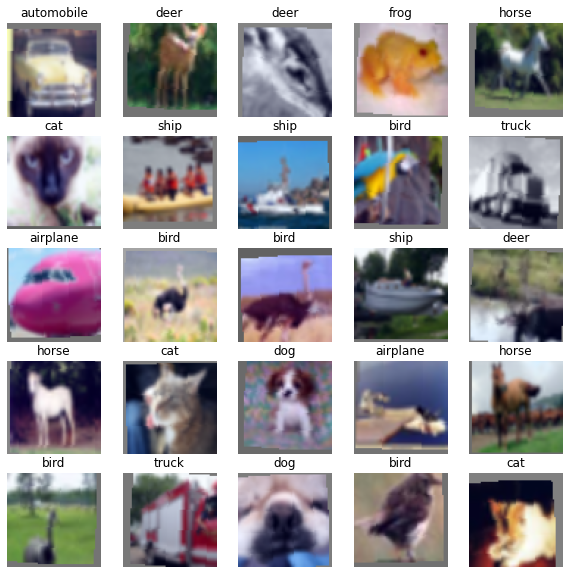


Input samples with filters applied from the first layer:



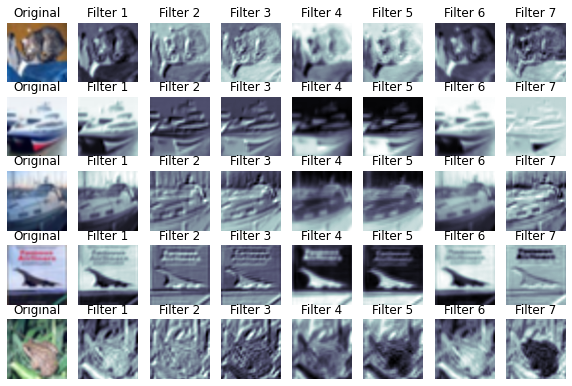


First layer filters visualization:



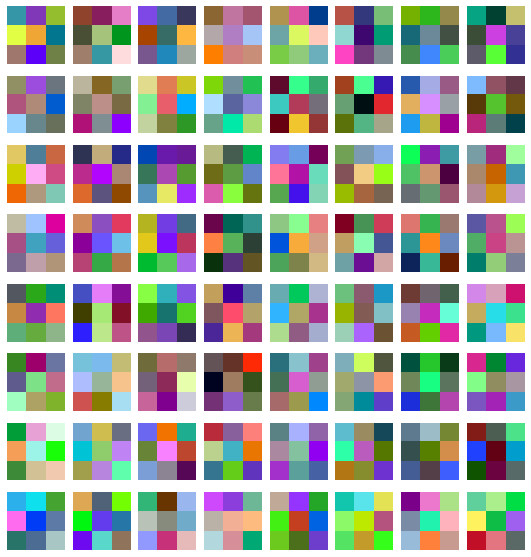


  0%|          | 0/40 [00:00<?, ?it/s]


  2%|▎         | 1/40 [01:19<51:42, 79.56s/it]

2021-05-15-19:21:04 Epoch: 1
 lr: 0.0001, train_loss: 0.035937, train_acc: 10.11, val_loss: 0.035962, val_acc: 10.42, epoch_time: 79.56



  5%|▌         | 2/40 [02:38<50:16, 79.38s/it]

2021-05-15-19:22:23 Epoch: 2
 lr: 0.0001, train_loss: 0.035825, train_acc: 10.79, val_loss: 0.035800, val_acc: 14.28, epoch_time: 78.95



  8%|▊         | 3/40 [03:57<48:53, 79.28s/it]

2021-05-15-19:23:42 Epoch: 3
 lr: 0.0001, train_loss: 0.035572, train_acc: 12.17, val_loss: 0.035346, val_acc: 12.43, epoch_time: 79.03



 10%|█         | 4/40 [05:16<47:34, 79.28s/it]

2021-05-15-19:25:01 Epoch: 4
 lr: 0.0001, train_loss: 0.034836, train_acc: 16.05, val_loss: 0.033755, val_acc: 23.83, epoch_time: 79.27



 12%|█▎        | 5/40 [06:36<46:17, 79.35s/it]

2021-05-15-19:26:21 Epoch: 5
 lr: 0.0001, train_loss: 0.032797, train_acc: 22.67, val_loss: 0.031266, val_acc: 26.46, epoch_time: 79.49



 15%|█▌        | 6/40 [07:56<45:00, 79.44s/it]

2021-05-15-19:27:41 Epoch: 6
 lr: 0.0001, train_loss: 0.031132, train_acc: 26.54, val_loss: 0.030030, val_acc: 29.22, epoch_time: 79.65



 18%|█▊        | 7/40 [09:14<43:35, 79.26s/it]

2021-05-15-19:28:59 Epoch: 7
 lr: 0.0001, train_loss: 0.029706, train_acc: 29.33, val_loss: 0.028704, val_acc: 31.94, epoch_time: 78.81



 20%|██        | 8/40 [10:33<42:14, 79.19s/it]

2021-05-15-19:30:18 Epoch: 8
 lr: 0.0001, train_loss: 0.028559, train_acc: 31.71, val_loss: 0.027372, val_acc: 34.34, epoch_time: 79.03



 22%|██▎       | 9/40 [11:53<40:56, 79.24s/it]

2021-05-15-19:31:38 Epoch: 9
 lr: 0.0001, train_loss: 0.027501, train_acc: 34.44, val_loss: 0.026478, val_acc: 37.66, epoch_time: 79.32



 25%|██▌       | 10/40 [13:12<39:34, 79.15s/it]

2021-05-15-19:32:57 Epoch: 10
 lr: 0.0001, train_loss: 0.026727, train_acc: 36.61, val_loss: 0.025681, val_acc: 39.71, epoch_time: 78.92



 28%|██▊       | 11/40 [14:31<38:16, 79.18s/it]

2021-05-15-19:34:16 Epoch: 11
 lr: 0.0001, train_loss: 0.026158, train_acc: 37.73, val_loss: 0.026282, val_acc: 39.05, epoch_time: 79.26



 30%|███       | 12/40 [15:50<36:55, 79.12s/it]

2021-05-15-19:35:35 Epoch: 12
 lr: 0.0001, train_loss: 0.025456, train_acc: 39.47, val_loss: 0.024623, val_acc: 41.87, epoch_time: 78.97



 32%|███▎      | 13/40 [17:09<35:38, 79.19s/it]

2021-05-15-19:36:54 Epoch: 13
 lr: 0.0001, train_loss: 0.024912, train_acc: 41.03, val_loss: 0.024082, val_acc: 43.09, epoch_time: 79.34



 35%|███▌      | 14/40 [18:28<34:18, 79.19s/it]

2021-05-15-19:38:13 Epoch: 14
 lr: 0.0001, train_loss: 0.024441, train_acc: 42.42, val_loss: 0.023832, val_acc: 44.13, epoch_time: 79.18



 38%|███▊      | 15/40 [19:47<32:56, 79.04s/it]

2021-05-15-19:39:32 Epoch: 15
 lr: 0.0001, train_loss: 0.023925, train_acc: 44.08, val_loss: 0.022934, val_acc: 46.19, epoch_time: 78.69



 40%|████      | 16/40 [21:06<31:36, 79.01s/it]

2021-05-15-19:40:51 Epoch: 16
 lr: 0.0001, train_loss: 0.023571, train_acc: 44.59, val_loss: 0.022956, val_acc: 46.15, epoch_time: 78.90



 42%|████▎     | 17/40 [22:25<30:17, 79.01s/it]

2021-05-15-19:42:10 Epoch: 17
 lr: 0.0001, train_loss: 0.023020, train_acc: 46.01, val_loss: 0.022540, val_acc: 47.59, epoch_time: 79.02



 45%|████▌     | 18/40 [23:44<28:57, 78.97s/it]

2021-05-15-19:43:29 Epoch: 18
 lr: 0.0001, train_loss: 0.022558, train_acc: 47.35, val_loss: 0.022132, val_acc: 47.99, epoch_time: 78.84



 48%|████▊     | 19/40 [25:03<27:37, 78.93s/it]

2021-05-15-19:44:48 Epoch: 19
 lr: 0.0001, train_loss: 0.022221, train_acc: 48.12, val_loss: 0.022257, val_acc: 48.13, epoch_time: 78.83



 50%|█████     | 20/40 [26:22<26:19, 78.99s/it]

2021-05-15-19:46:07 Epoch: 20
 lr: 0.0001, train_loss: 0.021820, train_acc: 49.27, val_loss: 0.021205, val_acc: 49.93, epoch_time: 79.12



 52%|█████▎    | 21/40 [27:41<25:00, 78.97s/it]

2021-05-15-19:47:26 Epoch: 21
 lr: 0.0001, train_loss: 0.021405, train_acc: 50.18, val_loss: 0.020649, val_acc: 51.85, epoch_time: 78.91



 55%|█████▌    | 22/40 [29:00<23:42, 79.01s/it]

2021-05-15-19:48:45 Epoch: 22
 lr: 0.0001, train_loss: 0.021104, train_acc: 50.69, val_loss: 0.020930, val_acc: 51.17, epoch_time: 79.10



 57%|█████▊    | 23/40 [30:19<22:22, 78.96s/it]

2021-05-15-19:50:04 Epoch: 23
 lr: 0.0001, train_loss: 0.020625, train_acc: 51.89, val_loss: 0.019772, val_acc: 54.29, epoch_time: 78.83



 60%|██████    | 24/40 [31:38<21:04, 79.04s/it]

2021-05-15-19:51:23 Epoch: 24
 lr: 0.0001, train_loss: 0.020380, train_acc: 52.75, val_loss: 0.020306, val_acc: 52.68, epoch_time: 79.21



 62%|██████▎   | 25/40 [32:57<19:44, 78.99s/it]

2021-05-15-19:52:42 Epoch: 25
 lr: 0.0001, train_loss: 0.020079, train_acc: 53.59, val_loss: 0.019590, val_acc: 54.77, epoch_time: 78.85



 65%|██████▌   | 26/40 [34:16<18:26, 79.03s/it]

2021-05-15-19:54:01 Epoch: 26
 lr: 0.0001, train_loss: 0.019900, train_acc: 53.91, val_loss: 0.019388, val_acc: 55.43, epoch_time: 79.12



 68%|██████▊   | 27/40 [35:35<17:07, 79.00s/it]

2021-05-15-19:55:20 Epoch: 27
 lr: 0.0001, train_loss: 0.019593, train_acc: 54.82, val_loss: 0.019650, val_acc: 54.63, epoch_time: 78.92



 70%|███████   | 28/40 [36:54<15:47, 78.94s/it]

2021-05-15-19:56:39 Epoch: 28
 lr: 0.0001, train_loss: 0.019187, train_acc: 55.51, val_loss: 0.018810, val_acc: 56.87, epoch_time: 78.78



 72%|███████▎  | 29/40 [38:13<14:27, 78.89s/it]

2021-05-15-19:57:58 Epoch: 29
 lr: 0.0001, train_loss: 0.018910, train_acc: 56.15, val_loss: 0.018621, val_acc: 57.15, epoch_time: 78.77



 75%|███████▌  | 30/40 [39:31<13:08, 78.84s/it]

2021-05-15-19:59:16 Epoch: 30
 lr: 0.0001, train_loss: 0.018607, train_acc: 57.12, val_loss: 0.018128, val_acc: 57.89, epoch_time: 78.70



 78%|███████▊  | 31/40 [40:50<11:49, 78.86s/it]

2021-05-15-20:00:35 Epoch: 31
 lr: 0.0001, train_loss: 0.018328, train_acc: 57.85, val_loss: 0.018497, val_acc: 57.72, epoch_time: 78.89



 80%|████████  | 32/40 [42:09<10:31, 78.99s/it]

2021-05-15-20:01:54 Epoch: 32
 lr: 0.0001, train_loss: 0.018010, train_acc: 58.47, val_loss: 0.017662, val_acc: 59.64, epoch_time: 79.28



 82%|████████▎ | 33/40 [43:28<09:11, 78.83s/it]

2021-05-15-20:03:13 Epoch: 33
 lr: 0.0001, train_loss: 0.017728, train_acc: 59.03, val_loss: 0.017455, val_acc: 59.76, epoch_time: 78.47



 85%|████████▌ | 34/40 [44:47<07:53, 78.95s/it]

2021-05-15-20:04:32 Epoch: 34
 lr: 0.0001, train_loss: 0.017471, train_acc: 59.80, val_loss: 0.017508, val_acc: 60.16, epoch_time: 79.22



 88%|████████▊ | 35/40 [46:07<06:35, 79.09s/it]

2021-05-15-20:05:52 Epoch: 35
 lr: 0.0001, train_loss: 0.017256, train_acc: 60.06, val_loss: 0.016823, val_acc: 61.53, epoch_time: 79.39



 90%|█████████ | 36/40 [47:26<05:16, 79.16s/it]

2021-05-15-20:07:11 Epoch: 36
 lr: 0.0001, train_loss: 0.017028, train_acc: 60.95, val_loss: 0.017062, val_acc: 60.72, epoch_time: 79.34



 92%|█████████▎| 37/40 [48:45<03:57, 79.21s/it]

2021-05-15-20:08:30 Epoch: 37
 lr: 0.0001, train_loss: 0.016730, train_acc: 61.54, val_loss: 0.016762, val_acc: 62.31, epoch_time: 79.30



 95%|█████████▌| 38/40 [50:05<02:38, 79.32s/it]

2021-05-15-20:09:50 Epoch: 38
 lr: 0.0001, train_loss: 0.016488, train_acc: 61.94, val_loss: 0.016125, val_acc: 63.23, epoch_time: 79.58



 98%|█████████▊| 39/40 [51:24<01:19, 79.32s/it]

2021-05-15-20:11:09 Epoch: 39
 lr: 0.0001, train_loss: 0.016242, train_acc: 62.88, val_loss: 0.015827, val_acc: 64.45, epoch_time: 79.29



100%|██████████| 40/40 [52:43<00:00, 79.28s/it]
                                               

2021-05-15-20:12:28 Epoch: 40
 lr: 0.0001, train_loss: 0.015996, train_acc: 63.46, val_loss: 0.016552, val_acc: 62.53, epoch_time: 79.20

Confusion Martix:



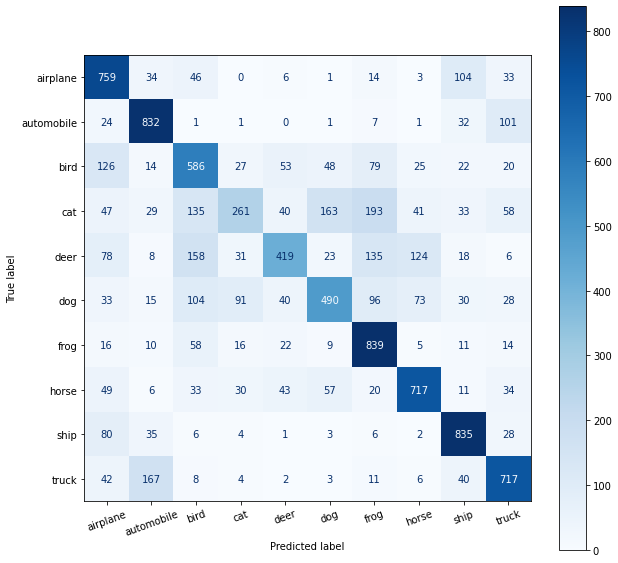


Finished! Accuracy: 64.55, Loss: 0.015830316108465196, Total time: 00:52:43.84.


In [20]:
model = 'vgg16'
dataset_name = 'cifar10'
classifier = DeepClassifier(model, dataset_name, normalize=True)

optimizer='SGD'
momentum = 0.9
start_lr = 0.0001
batch_size = 64
classifier.execute(log_dir=f'v4/{model}', epochs=40, learning_rate=start_lr, batch_size=batch_size, optimizer_name=optimizer, momentum=momentum)

In [16]:
class DeepClassifier(object):
    def __init__(self, model_name: str, dataset_name: str, train_percentage_size: float = 0.7,
                 normalize: bool = True, over_write: bool = False):
        self.data_dir = f'{DATA_DIR}/{dataset_name}'
        self.result_dir = f'{SAVE_DIR}/{model_name}'
        self.model_name = model_name
        self.dataset_name = dataset_name
        self.model = self.__init_model()
        self.datasets = self.__init_dataset(train_percentage_size, normalize, over_write)
        self.dataloaders = None
        self.summary_writer = None
        self.optimizer = None
        self.criterion = None
        self.scheduler = None

    def __init_model(self):
        """
        Initiate teh desired model
        :return: model to be used in training
        """
        if self.model_name == 'vgg16_bn':
            model = vgg16_bn(pretrained=False, num_classes=10)
        elif self.model_name == 'resnet':
            model = ResNet(num_classes=10)
        elif self.model_name == 'google_net':
            model = GoogLeNet(num_classes=10)
        else:
            raise Exception(f'Wrong model name: {self.model_name}. Must be in {MODELS}.')
        print('\n\n')
        
        return model

    def set_optimizer(self, optimizer_name: str, learning_rate: float, momentum: float = 0, weight_decay: float = 0):
        """
        Initiate the required optimizer
        :param optimizer_name:
        :param learning_rate:
        :param momentum:
        :param weight_decay:
        :return:
        """
        if optimizer_name == 'SGD':
            self.optimizer = optim.SGD(self.model.parameters(), learning_rate, momentum=momentum,
                                       weight_decay=weight_decay)
        elif optimizer_name == 'Adam':
            self.optimizer = optim.Adam(self.model.parameters(), learning_rate, weight_decay=weight_decay)
        else:
            raise Exception(f'Wrong optimizer name: {optimizer_name}. Must be in {OPTIMIZERS}.')
        return None

    def __init_dataset(self, train_percentage_size: float, normalize: bool = True, overwrite: bool = False):
        """
        Download or reload dataset and transform it accordingly.
        :param train_percentage_size: splitting training dataset to training and validation
        :param overwrite: True id re-downloading dataset is required
        :return: a dictionary of training, validation and testing datasets
        """
        print("\nLoading dataset ...\n")
        if overwrite:
            os.remove(self.data_dir)

        # initiate transformers
        transformers = {
            TRAIN: [
                transforms.ToTensor(),
            ],
            TEST:  [
                transforms.ToTensor(),
            ],
        }
        if self.dataset_name == 'mnist':
            dataset = datasets.MNIST
            # mnist mean and standard deviation 
            means = [0.1307]
            stds = [0.3081]
        elif self.dataset_name == 'fmnist':
            dataset = datasets.FashionMNIST
            # fmnist mean and standard deviation 
            means = [0.2860] 
            stds = [0.3530]
        elif self.dataset_name == 'cifar10':
            dataset = datasets.CIFAR10
            # cifar10 mean and standard deviation 
            means = [0.491, 0.482, 0.427]
            stds = [0.247, 0.243, 0.262]
        else:
            raise Exception(f'Wrong dataset name: {self.dataset_name}. Must be in {DATASETS}')

        if 'mnist' in self.dataset_name:
            # mnist and fashion mnist are in grayscale
            # transform single channel (grayscale) to 3 channels
            transformers[TRAIN].append(transforms.Lambda(lambda x: x.repeat(3, 1, 1)))
            transformers[TEST].append(transforms.Lambda(lambda x: x.repeat(3, 1, 1)))
        
        if 'vgg' in self.model_name:
            # resize input image to 64x64 for vgg model
            image_size = 64
        else:
            # resize input image to 32x32 for resnet and google_net models
            image_size = 32   
        transformers[TRAIN].append(transforms.Resize((image_size, image_size)))
        transformers[TEST].append(transforms.Resize((image_size, image_size)))

        # apply normalization according to the mean and std for each channel per dataset
        if normalize:
            transformers[TRAIN].append(transforms.Normalize(mean=means, std=stds))
            transformers[TEST].append(transforms.Normalize(mean=means, std=stds))
  
        # data augmentation
        transformers[TRAIN].extend([
            transforms.RandomRotation(5),
            transforms.RandomHorizontalFlip(0.5),
            transforms.RandomCrop(image_size, padding=5),
        ])
        
        # download or reload training data and transform it
        training_dataset = dataset(
            root=f'{self.data_dir}/{TRAIN}',
            train=True,
            download=True,
            transform=transforms.Compose(transformers[TRAIN])
        )
        # download or reload testing data and transform
        test_dataset = dataset(
            root=f'{self.data_dir}/{TEST}',
            train=False,
            download=True,
            transform=transforms.Compose(transformers[TEST])
        )
        # split training and validation datasets
        train_size = int(len(training_dataset) * train_percentage_size)
        validation_size = len(training_dataset) - train_size
        train_dataset, validate_dataset = torch.utils.data.random_split(
            dataset=training_dataset,
            lengths=[train_size, validation_size]
        )
        _datasets = {
            TRAIN: train_dataset,
            VALIDATION: validate_dataset,
            TEST: test_dataset,
        }
        return _datasets

    def set_data_loaders(self, batch_size: int = 256):
        """
        Create data loaders for the specified datasets with batch_size.
        :param batch_size: batch size, to specify in dataloader
        :return: None
        """
        print("\nInitiating dataloaders ...\n")
        # Create data loaders with defined batch sizes
        dataloaders = {
            TRAIN: DataLoader(self.datasets[TRAIN], batch_size=batch_size, shuffle=True),
            VALIDATION: DataLoader(self.datasets[VALIDATION], batch_size=batch_size),
            TEST: DataLoader(self.datasets[TEST], batch_size=batch_size, shuffle=True)
        }
        
        # Info about the dataset
        data_shape = dataloaders[TRAIN].dataset.dataset.data.shape[1:]
        D_in = np.prod(data_shape)
        D_out = len(dataloaders[TRAIN].dataset.dataset.targets)
        for _key in [TRAIN, VALIDATION]:
            samples_size = len(dataloaders[_key].dataset.indices)
            shapes = ','.join([str(x) for x in dataloaders[_key].dataset.dataset.data.shape[1:]])
            print(f"{_key} dataset: [{samples_size},{shapes}]")
        print(f"{TEST} dataset: [{','.join([str(x) for x in dataloaders[TEST].dataset.data.shape])}]")
        
        self.dataloaders = dataloaders
        return None

    def train(self, device):
        """
        Train the model using the passed optimizer and loss function
        :param device: device to be used in training
        :return:
        """
        # set model to training mode
        self.model.train()
        train_loss = 0
        total_correct = 0
        for batch, (X, y) in enumerate(self.dataloaders[TRAIN]):
            if device:
                X, y = X.to(device), y.to(device)
            y_pred = self.model(X)
            loss = self.criterion(y_pred, y)

            # train and backpropagate
            self.optimizer.zero_grad()

            loss.backward()
            self.optimizer.step()

            train_loss += loss.item()
            total_correct += torch.sum(y_pred.argmax(1) == y).item()

        train_size = len(self.dataloaders[TRAIN].dataset)
        train_loss /= train_size
        accuracy = 100 * total_correct / train_size
        return train_loss, accuracy

    def validate(self, device):
        """
        Test or validate model
        :param device: device to be used in validation
        :return:
        """
        test_loss, total_correct = 0, 0
        # set model to evaluation mode
        self.model.eval()
        with torch.no_grad():
            for X, y in self.dataloaders[VALIDATION]:
                if device:
                    X, y = X.to(device), y.to(device)

                pred = self.model(X)
                test_loss += self.criterion(pred, y).item()
                total_correct += torch.sum(pred.argmax(1) == y).item()

        dataset_size = len(self.dataloaders[VALIDATION].dataset)
        test_loss /= dataset_size
        accuracy = 100 * total_correct / dataset_size
        return test_loss, accuracy

    def run_one_epoch(self, log_path: str, epoch_num: int, device):
        """
        Train the model then validate one epoch
        :param log_path: log path for tensorboard
        :param epoch_num: the current epoch number
        :param device: device to be used in training and validation
        :return:
        """
        epoch_start_time = time.time()
        train_loss, train_acc = self.train(device)
        self.summary_writer.add_scalar('epoch_loss/train', train_loss, epoch_num)
        self.summary_writer.add_scalar('epoch_accuracy/train', train_acc, epoch_num)

        current_lr =  self.optimizer.param_groups[0]['lr']
        self.summary_writer.add_scalar('learning_rate/train',current_lr, epoch_num)

        val_loss, val_acc = self.validate(device)
        self.summary_writer.add_scalar('epoch_loss/validation', val_loss, epoch_num)
        self.summary_writer.add_scalar('epoch_accuracy/validation', val_acc, epoch_num)

        self.scheduler.step(val_acc)

        epoch_end_time = time.time()
        epoch_total_time = epoch_end_time - epoch_start_time

        log_text = f'{datetime.now().strftime("%Y-%m-%d-%H:%M:%S")} Epoch: {epoch_num}\n lr: {current_lr}, train_loss: {train_loss:f}, train_acc: {train_acc:.2f}, val_loss: {val_loss:f}, val_acc: {val_acc:.2f}, epoch_time: {epoch_total_time:.2f}'
        print(log_text)
        self.summary_writer.add_text(log_path, log_text, global_step=epoch_num)
        return current_lr

    def run_testing(self, device):
        """
        Test the model and get prediction
        :param device: device to be used in validation
        :return:
        """
        self.model.eval()
        labels = []
        pred_labels = []
        test_loss = 0
        total_correct = 0
        with torch.no_grad():
            for X, y in self.dataloaders[TEST]:
                if device:
                    X, y = X.to(device), y.to(device)

                y_pred = self.model(X)
                test_loss += self.criterion(y_pred, y).item()
                total_correct += torch.sum(y_pred.argmax(1) == y).item()
                y_pred = y_pred.argmax(1)

                labels.append(y.cpu())
                pred_labels.append(y_pred.cpu())

        labels = torch.cat(labels, dim=0)
        pred_labels = torch.cat(pred_labels, dim=0)

        dataset_size = len(self.dataloaders[TEST].dataset)
        test_loss /= dataset_size
        accuracy = 100 * total_correct / dataset_size

        return test_loss, accuracy, labels, pred_labels

    @staticmethod
    def plot_confusion_matrix(labels, pred_labels, classes):

        fig = plt.figure(figsize=(10, 10))
        ax = fig.add_subplot(1, 1, 1)
        cm = confusion_matrix(labels, pred_labels)
        cm = ConfusionMatrixDisplay(cm, display_labels=classes)
        cm.plot(values_format='d', cmap='Blues', ax=ax)
        plt.xticks(rotation=20)
        print('\nConfusion Martix:\n')
        plt.show()
        return fig

    @staticmethod
    def normalize_image(image):
        image_min = image.min()
        image_max = image.max()
        image.clamp_(min=image_min, max=image_max)
        image.add_(-image_min).div_(image_max - image_min + 1e-5)
        return image

    def plot_input_examples(self, images, labels, classes, normalize=True):
        n_images = len(images)
        rows = int(np.sqrt(n_images))
        cols = int(np.sqrt(n_images))
        fig = plt.figure(figsize=(10, 10))
        for i in range(rows * cols):
            ax = fig.add_subplot(rows, cols, i + 1)
            image = images[i]
            if normalize:
                image = self.normalize_image(image)
            ax.imshow(image.permute(1, 2, 0).cpu().numpy())
            ax.set_title(classes[labels[i]])
            ax.axis('off')
        print('\nInput Samples:\n')
        plt.show()
        return fig

    def plot_filtered_images(self, images, filters, n_filters=None, normalize=True):
        images = torch.cat([i.unsqueeze(0) for i in images], dim=0).cpu()
        filters = filters.cpu()

        if n_filters is not None:
            filters = filters[:n_filters]

        n_images = images.shape[0]
        n_filters = filters.shape[0]
        filtered_images = F.conv2d(images, filters)
        fig = plt.figure(figsize=(10, 10))

        for i in range(n_images):
            image = images[i]
            if normalize:
                image = self.normalize_image(image)
            ax = fig.add_subplot(n_images, n_filters + 1, i + 1 + (i * n_filters))
            ax.imshow(image.permute(1, 2, 0).numpy())
            ax.set_title('Original')
            ax.axis('off')

            for j in range(n_filters):
                image = filtered_images[i][j]
                if normalize:
                    image = self.normalize_image(image)
                ax = fig.add_subplot(n_images, n_filters + 1, i + 1 + (i * n_filters) + j + 1)
                ax.imshow(image.numpy(), cmap='bone')
                ax.set_title(f'Filter {j + 1}')
                ax.axis('off')

        fig.subplots_adjust(hspace=-0.7)
        print('\nInput samples with filters applied from the first layer:\n')
        plt.show()
        return fig

    def plot_filters(self, filters, normalize=True):

        filters = filters.cpu()
        n_filters = filters.shape[0]

        rows = int(np.sqrt(n_filters))
        cols = int(np.sqrt(n_filters))

        fig = plt.figure(figsize=(20, 10))

        for i in range(rows * cols):
            image = filters[i]
            if normalize:
                image = self.normalize_image(image)
            ax = fig.add_subplot(rows, cols, i + 1)
            ax.imshow(image.permute(1, 2, 0))
            ax.axis('off')
        fig.subplots_adjust(wspace=-0.9)
        print('\nFirst layer filters visualization:\n')
        plt.show()
        return fig

    def plot_output_examples(self, images_set, labels_set, classes, normalize=True):
        fig = plt.figure(figsize=(10, 10))
        outer = gridspec.GridSpec(2, 1, wspace=0.2, hspace=0.2)
        sub_titles = ['Correct Classification', 'Incorrect Classification']
        for i, _title in enumerate(sub_titles):
            sub_ax = plt.Subplot(fig, outer[i])
            sub_ax._frameon = False
            sub_ax.axis('off')
            sub_ax.text(0.5, 1.1, _title, horizontalalignment='center', verticalalignment='top')
            fig.add_subplot(sub_ax)
            inner = gridspec.GridSpecFromSubplotSpec(2, 5, subplot_spec=outer[i], wspace=0.1, hspace=0.1)
            _images = images_set[i]
            _labels = labels_set[i]
            for j in range(5 * 2):
                ax = plt.Subplot(fig, inner[j])
                image = _images[j]
                if normalize:
                    image = self.normalize_image(image)
                ax.imshow(image.permute(1, 2, 0).cpu().numpy())
                ax.set_title(classes[_labels[j]])
                ax.axis('off')
                fig.add_subplot(ax)
        fig.show()
        return fig

    def plot_input_samples(self, log_path: str):
        """

        :param log_path:
        :return:
        """
        # plot input samples:
        N_IMAGES = 25
        images, labels = zip(*[(image, label) for image, label in
                               [self.datasets[TRAIN][i] for i in range(N_IMAGES)]])
        classes = self.datasets[TEST].classes
        samples = self.plot_input_examples(images, labels, classes)
        self.summary_writer.add_figure(f"{log_path}/input_samples", samples)
        return None

    def plot_filter_samples(self, log_path: str):
        """

        :param log_path:
        :return:
        """
        N_IMAGES = 5
        N_FILTERS = 7

        images = [image for image, label in [self.datasets[TEST][i] for i in range(N_IMAGES)]]
        if 'vgg' in self.model_name:
            filters = self.model.features[0].weight.data
        else:
            filters = self.model.input_layer[0].weight.data
        filtered_samples = self.plot_filtered_images(images, filters, N_FILTERS)
        self.summary_writer.add_figure(f"{log_path}/filtered_samples", filtered_samples)
        filters = self.plot_filters(filters)
        self.summary_writer.add_figure(f"{log_path}/filters", filters)
        return None

    def evaluate_model(self, path, device):
        classes = self.datasets[TEST].classes

        loss, acc, labels, pred_labels = self.run_testing(device)
        cm_image = self.plot_confusion_matrix(labels, pred_labels, classes)
        self.summary_writer.add_figure(f"{path}/confusion_matrix", cm_image)

        N_IMAGES = 10
        correct_images = []
        correct_labels = []
        incorrect_images = []
        incorrect_labels = []

        for i, _pred_label in enumerate(pred_labels):
            is_correct = _pred_label.item() == self.datasets[TEST][i][1]
            if is_correct and len(correct_images) != N_IMAGES:
                correct_images.append(self.datasets[TEST][i][0])
                correct_labels.append(pred_labels[i])
            elif not is_correct and len(incorrect_images) != N_IMAGES:
                incorrect_images.append(self.datasets[TEST][i][0])
                incorrect_labels.append(pred_labels[i])

            if len(correct_images) == N_IMAGES and len(incorrect_images) == N_IMAGES:
                break

        samples = self.plot_output_examples([correct_images, incorrect_images], [correct_labels, incorrect_labels],
                                            classes)
        self.summary_writer.add_figure(f"{path}/output_samples", samples)
        return loss, acc

    def execute(self, log_dir: str, epochs: int, learning_rate: float, batch_size: int,
                optimizer_name: str = 'SGD', normalize: bool = True, momentum: float = 0, weight_decay: float = 0):
        """

        :param log_dir:
        :param epochs:
        :param optimizer_name:
        :param normalize:
        :param learning_rate:
        :param batch_size:
        :param momentum:
        :param weight_decay:
        :return:
        """
        device = torch.device('cuda') if torch.cuda.is_available() else None
        if device:
            self.model = self.model.to(device)
        self.set_data_loaders(batch_size)
        self.criterion = nn.CrossEntropyLoss()
        self.set_optimizer(optimizer_name, learning_rate, momentum, weight_decay)
        self.scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(self.optimizer, mode='max', patience=2)
        

        current_time = datetime.now()
        run_name = f'{datetime.timestamp(current_time)}_{self.dataset_name}_{optimizer_name}' \
                       f'_{batch_size}_{learning_rate}_{momentum}_{weight_decay}'
        log_path = f'{SAVE_DIR}/{log_dir}/{run_name}'
        print(f"\nLog path: {log_path}\n")
        self.summary_writer = SummaryWriter(log_path)

        log_text = f'{current_time.strftime("%Y-%m-%d-%H:%M:%S")}, model: {self.model_name}, dataset: {self.dataset_name}, ' \
                   f'optimizer: {optimizer_name}, epochs: {epochs}, batch_size: {batch_size}, ' \
                   f'starting learning_rate: {learning_rate}, momentum: {momentum}'
        if weight_decay > 0:
            log_text += f', weight decay: {weight_decay}'

        print(f'{log_text}\n')
        self.summary_writer.add_text('', log_text)

        self.plot_input_samples(log_path)
        self.plot_filter_samples(log_path)
        print('\n')

        start_time = time.time()
        for _epoch in tqdm(range(1, epochs + 1), leave=False):
            current_lr = self.run_one_epoch(log_path, _epoch, device)
            if current_lr < learning_rate * 1e-4:
                break

        end_time = time.time()
        total_time = end_time - start_time
        hours, rem = divmod(total_time, 3600)
        minutes, seconds = divmod(rem, 60)
        elapsed_time = "{:0>2}:{:0>2}:{:05.2f}".format(int(hours), int(minutes), seconds)

        test_loss, test_acc = self.evaluate_model(run_name, device)
        self.summary_writer.add_hparams(hparam_dict={'model': self.model_name,
                                                     'dataset': self.dataset_name,
                                                     'epochs': epochs,
                                                     'learning_rate': learning_rate,
                                                     'batch_size': batch_size,
                                                     'optimizer': optimizer_name 
                                                     },
                                        metric_dict={'test_loss': test_loss, 'test_acc': test_acc},
                                        hparam_domain_discrete={'model': MODELS,
                                                                'dataset': DATASETS,
                                                                'epochs': [10, 40, 50, 100],
                                                                'learning_rate': LEARNING_RATES,
                                                                'batch_size': BATCH_SIZES, 
                                                                'optimizer': OPTIMIZERS,}
                                        )
        log_text = f'\nFinished! Accuracy: {test_acc}, Loss: {test_loss}, Total time: {elapsed_time}.'
        self.summary_writer.add_text('', log_text)
        print(log_text)
        self.summary_writer.close()
        return None


## **TRAIN and RESULT VGG16_bn**



1.  ### MNIST








Loading dataset ...


Initiating dataloaders ...

train dataset: [42000,28,28]
val dataset: [18000,28,28]
test dataset: [10000,28,28]

Log path: /content/drive/MyDrive/CW3/results/final/vgg16_bn/1621017640.902826_mnist_SGD_32_0.0001_0.9_0

2021-05-14-18:40:40, model: vgg16_bn, dataset: mnist, optimizer: SGD, epochs: 10, batch_size: 32, starting learning_rate: 0.0001, momentum: 0.9


Input Samples:



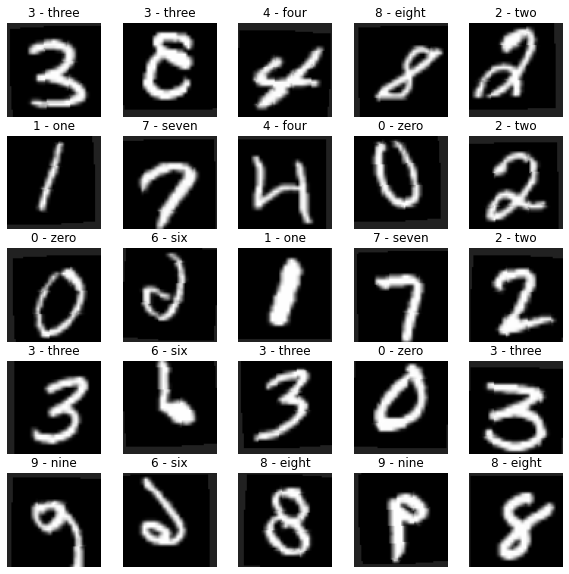


Input samples with filters applied from the first layer:



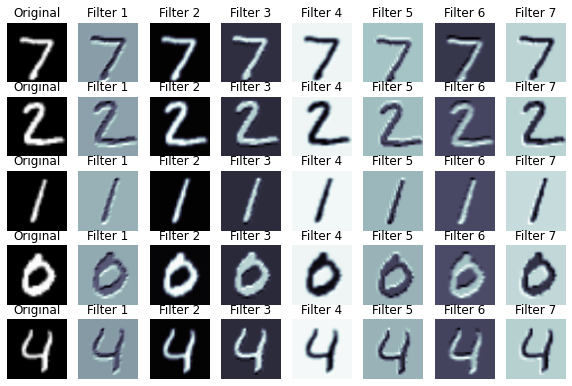


First layer filters visualization:



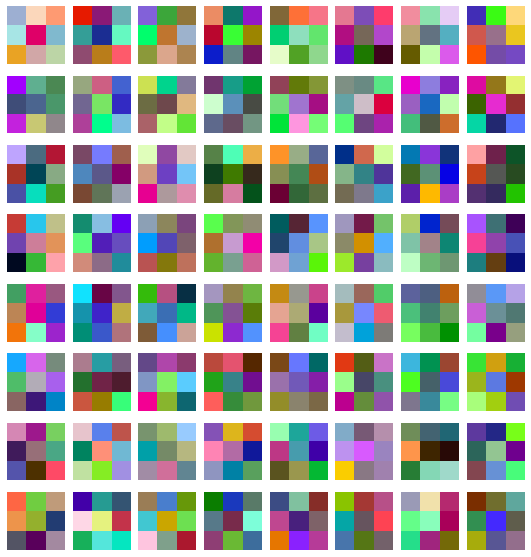

  0%|          | 0/10 [00:00<?, ?it/s]

 10%|█         | 1/10 [01:47<16:06, 107.40s/it]

2021-05-14-18:42:34 Epoch: 1
 lr: 0.0001, train_loss: 0.031821, train_acc: 65.12, val_loss: 0.010271, val_acc: 89.15, epoch_time: 107.40


 20%|██        | 2/10 [03:36<14:22, 107.77s/it]

2021-05-14-18:44:22 Epoch: 2
 lr: 0.0001, train_loss: 0.009350, train_acc: 90.31, val_loss: 0.005297, val_acc: 94.56, epoch_time: 108.63


 30%|███       | 3/10 [05:24<12:36, 108.02s/it]

2021-05-14-18:46:11 Epoch: 3
 lr: 0.0001, train_loss: 0.005886, train_acc: 94.15, val_loss: 0.003954, val_acc: 95.92, epoch_time: 108.61


 40%|████      | 4/10 [07:13<10:49, 108.20s/it]

2021-05-14-18:47:59 Epoch: 4
 lr: 0.0001, train_loss: 0.004544, train_acc: 95.43, val_loss: 0.003645, val_acc: 96.25, epoch_time: 108.62


 50%|█████     | 5/10 [09:01<09:01, 108.35s/it]

2021-05-14-18:49:48 Epoch: 5
 lr: 0.0001, train_loss: 0.003680, train_acc: 96.28, val_loss: 0.003015, val_acc: 96.77, epoch_time: 108.69


 60%|██████    | 6/10 [10:50<07:14, 108.52s/it]

2021-05-14-18:51:37 Epoch: 6
 lr: 0.0001, train_loss: 0.003280, train_acc: 96.76, val_loss: 0.002560, val_acc: 97.41, epoch_time: 108.91


 70%|███████   | 7/10 [12:39<05:25, 108.63s/it]

2021-05-14-18:53:26 Epoch: 7
 lr: 0.0001, train_loss: 0.002974, train_acc: 97.07, val_loss: 0.002402, val_acc: 97.47, epoch_time: 108.90


 80%|████████  | 8/10 [14:28<03:37, 108.61s/it]

2021-05-14-18:55:15 Epoch: 8
 lr: 0.0001, train_loss: 0.002689, train_acc: 97.39, val_loss: 0.002249, val_acc: 97.59, epoch_time: 108.56


 90%|█████████ | 9/10 [16:16<01:48, 108.52s/it]

2021-05-14-18:57:03 Epoch: 9
 lr: 0.0001, train_loss: 0.002500, train_acc: 97.50, val_loss: 0.002216, val_acc: 97.76, epoch_time: 108.30


2021-05-14-18:58:51 Epoch: 10
 lr: 0.0001, train_loss: 0.002267, train_acc: 97.73, val_loss: 0.002083, val_acc: 97.81, epoch_time: 108.01



Confusion Martix:



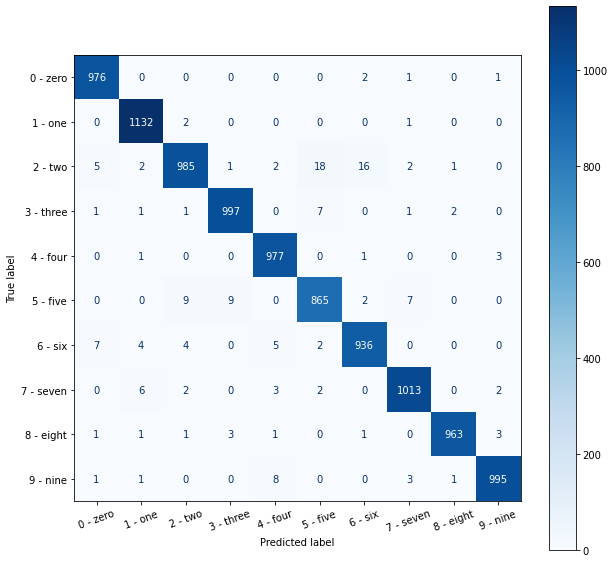


Finished! Accuracy: 98.39, Loss: 0.0014794055536272936, Total time: 00:18:04.66.


In [10]:
model = 'vgg16_bn'
dataset_name = 'mnist'
classifier = DeepClassifier(model, dataset_name, normalize=True)

optimizer='SGD'
momentum = 0.9
start_lr = 0.0001
batch_size = 32
classifier.execute(log_dir=f'final/{model}', epochs=10, learning_rate=start_lr, batch_size=batch_size, optimizer_name=optimizer, normalize=True, momentum=momentum)

2.  ### Fashion MNIST





Loading dataset ...


Initiating dataloaders ...

train dataset: [42000,28,28]
val dataset: [18000,28,28]
test dataset: [10000,28,28]

Log path: /content/drive/MyDrive/CW3/results/final/vgg16_bn/1620930161.718527_fmnist_SGD_32_0.0001_0.9_0

2021-05-13-18:22:41, model: vgg16_bn, dataset: fmnist, optimizer: SGD, epochs: 20, batch_size: 32, starting learning_rate: 0.0001, momentum: 0.9


Input Samples:



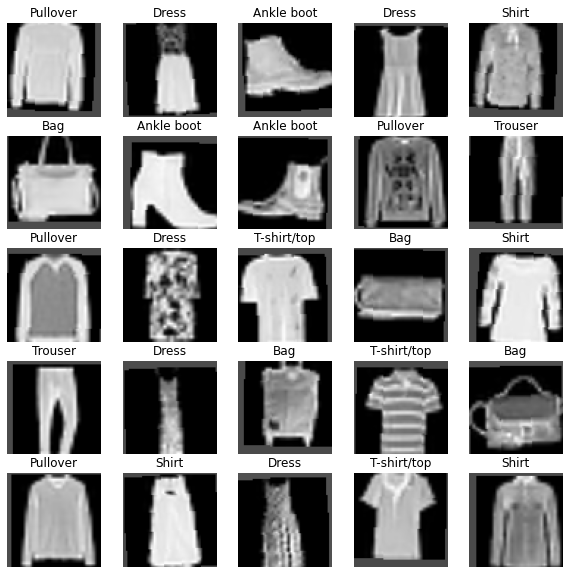


Input samples with filters applied from the first layer:



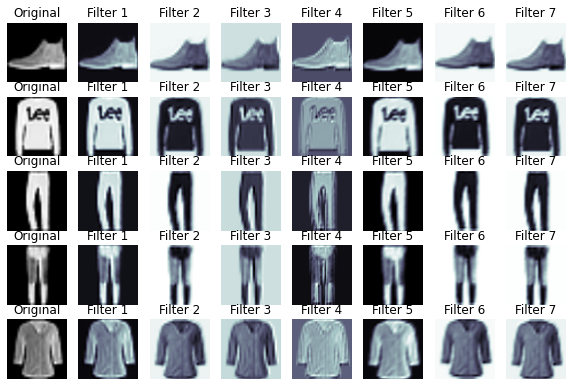


First layer filters visualization:



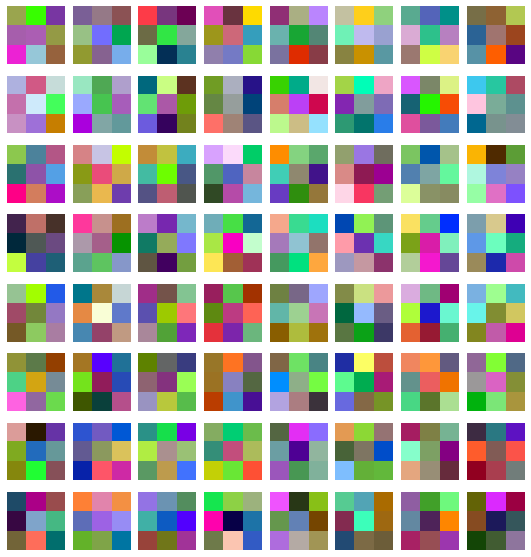

  0%|          | 0/20 [00:00<?, ?it/s]

  5%|▌         | 1/20 [02:15<43:00, 135.84s/it]

2021-05-13-18:25:01 Epoch: 1
 lr: 0.0001, train_loss: 0.035391, train_acc: 58.58, val_loss: 0.019235, val_acc: 76.49, epoch_time: 135.84


 10%|█         | 2/20 [04:31<40:43, 135.77s/it]

2021-05-13-18:27:17 Epoch: 2
 lr: 0.0001, train_loss: 0.019547, train_acc: 75.83, val_loss: 0.015944, val_acc: 80.62, epoch_time: 135.61


 15%|█▌        | 3/20 [06:49<38:39, 136.41s/it]

2021-05-13-18:29:35 Epoch: 3
 lr: 0.0001, train_loss: 0.016521, train_acc: 79.91, val_loss: 0.014012, val_acc: 83.04, epoch_time: 137.90


 20%|██        | 4/20 [09:06<36:28, 136.77s/it]

2021-05-13-18:31:53 Epoch: 4
 lr: 0.0001, train_loss: 0.014465, train_acc: 82.70, val_loss: 0.013704, val_acc: 83.52, epoch_time: 137.62


 25%|██▌       | 5/20 [11:23<34:11, 136.79s/it]

2021-05-13-18:34:09 Epoch: 5
 lr: 0.0001, train_loss: 0.013286, train_acc: 84.29, val_loss: 0.012219, val_acc: 85.57, epoch_time: 136.81


 30%|███       | 6/20 [13:40<31:55, 136.84s/it]

2021-05-13-18:36:26 Epoch: 6
 lr: 0.0001, train_loss: 0.012373, train_acc: 85.35, val_loss: 0.011216, val_acc: 86.82, epoch_time: 136.98


 35%|███▌      | 7/20 [15:57<29:39, 136.89s/it]

2021-05-13-18:38:43 Epoch: 7
 lr: 0.0001, train_loss: 0.011544, train_acc: 86.47, val_loss: 0.010917, val_acc: 87.15, epoch_time: 136.98


 40%|████      | 8/20 [18:14<27:21, 136.78s/it]

2021-05-13-18:41:00 Epoch: 8
 lr: 0.0001, train_loss: 0.010959, train_acc: 87.09, val_loss: 0.010393, val_acc: 87.74, epoch_time: 136.53


 45%|████▌     | 9/20 [20:31<25:04, 136.77s/it]

2021-05-13-18:43:17 Epoch: 9
 lr: 0.0001, train_loss: 0.010471, train_acc: 87.76, val_loss: 0.010248, val_acc: 88.04, epoch_time: 136.74


 50%|█████     | 10/20 [22:47<22:47, 136.77s/it]

2021-05-13-18:45:33 Epoch: 10
 lr: 0.0001, train_loss: 0.010032, train_acc: 88.21, val_loss: 0.010034, val_acc: 88.23, epoch_time: 136.78


 55%|█████▌    | 11/20 [25:04<20:30, 136.70s/it]

2021-05-13-18:47:50 Epoch: 11
 lr: 0.0001, train_loss: 0.009740, train_acc: 88.77, val_loss: 0.009511, val_acc: 88.97, epoch_time: 136.51


 60%|██████    | 12/20 [27:21<18:14, 136.82s/it]

2021-05-13-18:50:07 Epoch: 12
 lr: 0.0001, train_loss: 0.009448, train_acc: 88.83, val_loss: 0.009685, val_acc: 88.53, epoch_time: 137.12


 65%|██████▌   | 13/20 [29:38<15:57, 136.77s/it]

2021-05-13-18:52:24 Epoch: 13
 lr: 0.0001, train_loss: 0.009075, train_acc: 89.32, val_loss: 0.009107, val_acc: 89.12, epoch_time: 136.64


 70%|███████   | 14/20 [31:54<13:39, 136.60s/it]

2021-05-13-18:54:40 Epoch: 14
 lr: 0.0001, train_loss: 0.008865, train_acc: 89.73, val_loss: 0.008910, val_acc: 89.77, epoch_time: 136.20


 75%|███████▌  | 15/20 [34:11<11:23, 136.68s/it]

2021-05-13-18:56:57 Epoch: 15
 lr: 0.0001, train_loss: 0.008703, train_acc: 89.83, val_loss: 0.008693, val_acc: 89.90, epoch_time: 136.85


 80%|████████  | 16/20 [36:28<09:07, 136.78s/it]

2021-05-13-18:59:14 Epoch: 16
 lr: 0.0001, train_loss: 0.008439, train_acc: 90.08, val_loss: 0.008702, val_acc: 89.89, epoch_time: 137.02


 85%|████████▌ | 17/20 [38:44<06:49, 136.65s/it]

2021-05-13-19:01:30 Epoch: 17
 lr: 0.0001, train_loss: 0.008231, train_acc: 90.37, val_loss: 0.008446, val_acc: 90.16, epoch_time: 136.34


 90%|█████████ | 18/20 [41:00<04:32, 136.48s/it]

2021-05-13-19:03:46 Epoch: 18
 lr: 0.0001, train_loss: 0.008062, train_acc: 90.63, val_loss: 0.008251, val_acc: 90.38, epoch_time: 136.08


 95%|█████████▌| 19/20 [43:16<02:16, 136.37s/it]

2021-05-13-19:06:02 Epoch: 19
 lr: 0.0001, train_loss: 0.007882, train_acc: 90.85, val_loss: 0.008382, val_acc: 90.41, epoch_time: 136.10


2021-05-13-19:08:19 Epoch: 20
 lr: 0.0001, train_loss: 0.007648, train_acc: 91.13, val_loss: 0.008029, val_acc: 90.67, epoch_time: 136.20



Confusion Martix:



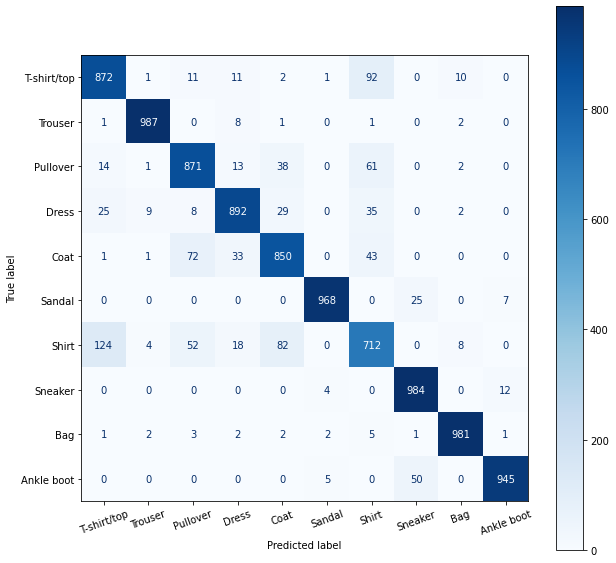


Finished! Accuracy: 90.62, Loss: 0.008097319532930851, Total time: 00:45:32.92.


In [ ]:
model = 'vgg16_bn'
dataset_name = 'fmnist'
classifier = DeepClassifier(model, dataset_name, normalize=True)

optimizer='SGD'
momentum = 0.9
start_lr = 0.0001
batch_size = 32
classifier.execute(log_dir=f'final/{model}', epochs=20, learning_rate=start_lr, batch_size=batch_size, optimizer_name=optimizer, normalize=True, momentum=momentum)

3.  ### CIFAR10





Loading dataset ...

Files already downloaded and verified
Files already downloaded and verified

Initiating dataloaders ...

train dataset: [35000,32,32,3]
val dataset: [15000,32,32,3]
test dataset: [10000,32,32,3]

Log path: /content/drive/MyDrive/CW3/results/final/vgg16_bn/1621007175.770339_cifar10_SGD_64_0.01_0.9_0

2021-05-14-15:46:15, model: vgg16_bn, dataset: cifar10, optimizer: SGD, epochs: 40, batch_size: 32, starting learning_rate: 0.01, momentum: 0.9


Input Samples:



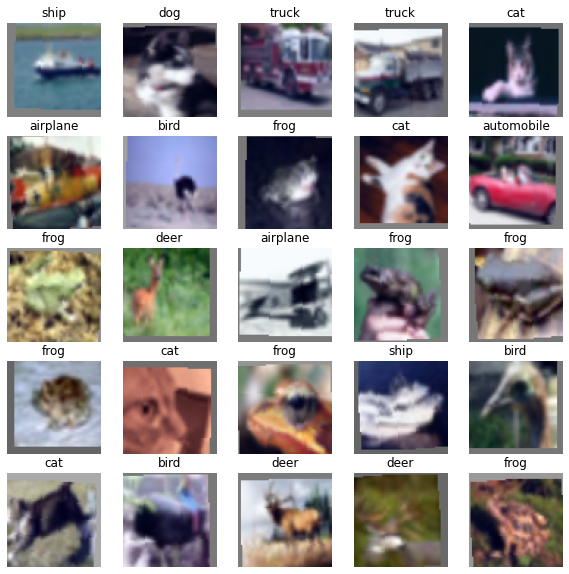


Input samples with filters applied from the first layer:



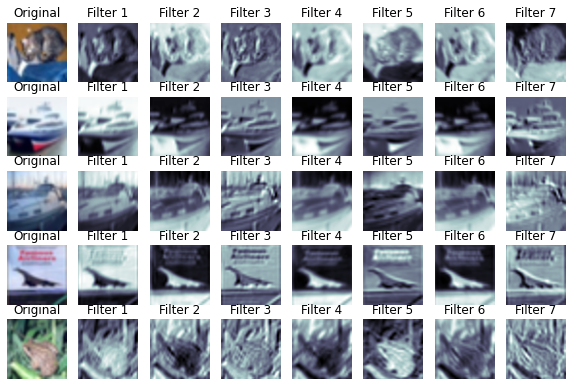


First layer filters visualization:



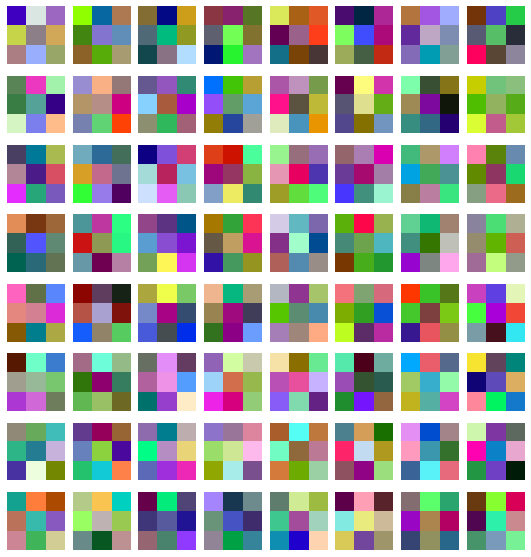

  0%|          | 0/40 [00:00<?, ?it/s]

  2%|▎         | 1/40 [01:18<50:44, 78.07s/it]

2021-05-14-15:47:39 Epoch: 1
 lr: 0.01, train_loss: 0.032111, train_acc: 24.07, val_loss: 0.028015, val_acc: 33.57, epoch_time: 78.07


  5%|▌         | 2/40 [02:35<49:20, 77.91s/it]

2021-05-14-15:48:56 Epoch: 2
 lr: 0.01, train_loss: 0.025305, train_acc: 39.48, val_loss: 0.022388, val_acc: 48.64, epoch_time: 77.52


  8%|▊         | 3/40 [03:53<47:59, 77.83s/it]

2021-05-14-15:50:14 Epoch: 3
 lr: 0.01, train_loss: 0.020836, train_acc: 52.13, val_loss: 0.019937, val_acc: 55.57, epoch_time: 77.65


 10%|█         | 4/40 [05:10<46:39, 77.76s/it]

2021-05-14-15:51:31 Epoch: 4
 lr: 0.01, train_loss: 0.017065, train_acc: 62.59, val_loss: 0.015130, val_acc: 66.31, epoch_time: 77.58


 12%|█▎        | 5/40 [06:28<45:22, 77.79s/it]

2021-05-14-15:52:49 Epoch: 5
 lr: 0.01, train_loss: 0.014229, train_acc: 69.13, val_loss: 0.013126, val_acc: 71.92, epoch_time: 77.86


 15%|█▌        | 6/40 [07:46<44:05, 77.82s/it]

2021-05-14-15:54:07 Epoch: 6
 lr: 0.01, train_loss: 0.012433, train_acc: 73.63, val_loss: 0.012972, val_acc: 73.26, epoch_time: 77.90


 18%|█▊        | 7/40 [09:04<42:47, 77.80s/it]

2021-05-14-15:55:25 Epoch: 7
 lr: 0.01, train_loss: 0.011009, train_acc: 76.71, val_loss: 0.010799, val_acc: 76.59, epoch_time: 77.76


 20%|██        | 8/40 [10:22<41:35, 77.99s/it]

2021-05-14-15:56:43 Epoch: 8
 lr: 0.01, train_loss: 0.009893, train_acc: 79.12, val_loss: 0.010708, val_acc: 76.96, epoch_time: 78.43


 22%|██▎       | 9/40 [11:41<40:23, 78.18s/it]

2021-05-14-15:58:02 Epoch: 9
 lr: 0.01, train_loss: 0.008882, train_acc: 81.18, val_loss: 0.010075, val_acc: 78.77, epoch_time: 78.61


 25%|██▌       | 10/40 [12:59<39:08, 78.28s/it]

2021-05-14-15:59:20 Epoch: 10
 lr: 0.01, train_loss: 0.008189, train_acc: 82.95, val_loss: 0.009919, val_acc: 78.75, epoch_time: 78.52


 28%|██▊       | 11/40 [14:18<37:50, 78.30s/it]

2021-05-14-16:00:39 Epoch: 11
 lr: 0.01, train_loss: 0.007478, train_acc: 84.10, val_loss: 0.008460, val_acc: 81.67, epoch_time: 78.36


 30%|███       | 12/40 [15:36<36:34, 78.37s/it]

2021-05-14-16:01:57 Epoch: 12
 lr: 0.01, train_loss: 0.006918, train_acc: 85.36, val_loss: 0.007989, val_acc: 82.80, epoch_time: 78.53


 32%|███▎      | 13/40 [16:55<35:18, 78.46s/it]

2021-05-14-16:03:16 Epoch: 13
 lr: 0.01, train_loss: 0.006562, train_acc: 86.26, val_loss: 0.007801, val_acc: 83.28, epoch_time: 78.66


 35%|███▌      | 14/40 [18:13<33:59, 78.46s/it]

2021-05-14-16:04:34 Epoch: 14
 lr: 0.01, train_loss: 0.005969, train_acc: 87.45, val_loss: 0.007856, val_acc: 83.26, epoch_time: 78.45


 38%|███▊      | 15/40 [19:32<32:40, 78.43s/it]

2021-05-14-16:05:53 Epoch: 15
 lr: 0.01, train_loss: 0.005587, train_acc: 88.13, val_loss: 0.008121, val_acc: 83.41, epoch_time: 78.36


 40%|████      | 16/40 [20:50<31:20, 78.35s/it]

2021-05-14-16:07:11 Epoch: 16
 lr: 0.01, train_loss: 0.005323, train_acc: 88.53, val_loss: 0.007733, val_acc: 83.67, epoch_time: 78.17


 42%|████▎     | 17/40 [22:08<30:02, 78.38s/it]

2021-05-14-16:08:29 Epoch: 17
 lr: 0.01, train_loss: 0.004825, train_acc: 89.56, val_loss: 0.007580, val_acc: 84.49, epoch_time: 78.45


 45%|████▌     | 18/40 [23:27<28:46, 78.50s/it]

2021-05-14-16:09:48 Epoch: 18
 lr: 0.01, train_loss: 0.004649, train_acc: 89.94, val_loss: 0.007013, val_acc: 85.27, epoch_time: 78.76


 48%|████▊     | 19/40 [24:45<27:22, 78.21s/it]

2021-05-14-16:11:06 Epoch: 19
 lr: 0.01, train_loss: 0.004301, train_acc: 90.84, val_loss: 0.007688, val_acc: 84.60, epoch_time: 77.53


 50%|█████     | 20/40 [26:02<26:00, 78.00s/it]

2021-05-14-16:12:23 Epoch: 20
 lr: 0.01, train_loss: 0.004108, train_acc: 91.23, val_loss: 0.006848, val_acc: 85.99, epoch_time: 77.52


 52%|█████▎    | 21/40 [27:20<24:40, 77.91s/it]

2021-05-14-16:13:41 Epoch: 21
 lr: 0.01, train_loss: 0.003811, train_acc: 91.85, val_loss: 0.006734, val_acc: 86.12, epoch_time: 77.70


 55%|█████▌    | 22/40 [28:37<23:18, 77.72s/it]

2021-05-14-16:14:58 Epoch: 22
 lr: 0.01, train_loss: 0.003632, train_acc: 92.24, val_loss: 0.007356, val_acc: 85.31, epoch_time: 77.28


 57%|█████▊    | 23/40 [29:55<22:02, 77.80s/it]

2021-05-14-16:16:16 Epoch: 23
 lr: 0.01, train_loss: 0.003416, train_acc: 92.68, val_loss: 0.006951, val_acc: 86.26, epoch_time: 77.98


 60%|██████    | 24/40 [31:14<20:50, 78.13s/it]

2021-05-14-16:17:35 Epoch: 24
 lr: 0.01, train_loss: 0.003158, train_acc: 93.26, val_loss: 0.007522, val_acc: 85.68, epoch_time: 78.89


 62%|██████▎   | 25/40 [32:32<19:33, 78.21s/it]

2021-05-14-16:18:53 Epoch: 25
 lr: 0.01, train_loss: 0.003028, train_acc: 93.49, val_loss: 0.006837, val_acc: 86.99, epoch_time: 78.39


 65%|██████▌   | 26/40 [33:51<18:14, 78.21s/it]

2021-05-14-16:20:12 Epoch: 26
 lr: 0.01, train_loss: 0.002789, train_acc: 94.02, val_loss: 0.007303, val_acc: 86.34, epoch_time: 78.22


 68%|██████▊   | 27/40 [35:09<16:57, 78.23s/it]

2021-05-14-16:21:30 Epoch: 27
 lr: 0.01, train_loss: 0.002666, train_acc: 94.23, val_loss: 0.006379, val_acc: 87.77, epoch_time: 78.28


 70%|███████   | 28/40 [36:28<15:40, 78.35s/it]

2021-05-14-16:22:49 Epoch: 28
 lr: 0.01, train_loss: 0.002535, train_acc: 94.67, val_loss: 0.007194, val_acc: 86.73, epoch_time: 78.62


 72%|███████▎  | 29/40 [37:46<14:20, 78.24s/it]

2021-05-14-16:24:07 Epoch: 29
 lr: 0.01, train_loss: 0.002332, train_acc: 94.87, val_loss: 0.007307, val_acc: 86.25, epoch_time: 78.00


 75%|███████▌  | 30/40 [39:03<13:00, 78.07s/it]

2021-05-14-16:25:24 Epoch: 30
 lr: 0.01, train_loss: 0.002288, train_acc: 95.12, val_loss: 0.006624, val_acc: 87.68, epoch_time: 77.68


 78%|███████▊  | 31/40 [40:21<11:40, 77.86s/it]

2021-05-14-16:26:42 Epoch: 31
 lr: 0.001, train_loss: 0.001202, train_acc: 97.41, val_loss: 0.006082, val_acc: 89.55, epoch_time: 77.37


 80%|████████  | 32/40 [41:38<10:22, 77.77s/it]

2021-05-14-16:27:59 Epoch: 32
 lr: 0.001, train_loss: 0.000932, train_acc: 98.00, val_loss: 0.006021, val_acc: 89.73, epoch_time: 77.56


 82%|████████▎ | 33/40 [42:56<09:04, 77.80s/it]

2021-05-14-16:29:17 Epoch: 33
 lr: 0.001, train_loss: 0.000772, train_acc: 98.36, val_loss: 0.006038, val_acc: 90.09, epoch_time: 77.88


 85%|████████▌ | 34/40 [44:14<07:46, 77.75s/it]

2021-05-14-16:30:35 Epoch: 34
 lr: 0.001, train_loss: 0.000708, train_acc: 98.54, val_loss: 0.006187, val_acc: 90.13, epoch_time: 77.61


 88%|████████▊ | 35/40 [45:31<06:28, 77.68s/it]

2021-05-14-16:31:52 Epoch: 35
 lr: 0.001, train_loss: 0.000658, train_acc: 98.55, val_loss: 0.006409, val_acc: 90.15, epoch_time: 77.53


 90%|█████████ | 36/40 [46:49<05:10, 77.69s/it]

2021-05-14-16:33:10 Epoch: 36
 lr: 0.001, train_loss: 0.000629, train_acc: 98.66, val_loss: 0.006517, val_acc: 89.89, epoch_time: 77.69


 92%|█████████▎| 37/40 [48:07<03:53, 77.72s/it]

2021-05-14-16:34:28 Epoch: 37
 lr: 0.001, train_loss: 0.000538, train_acc: 98.85, val_loss: 0.006623, val_acc: 90.07, epoch_time: 77.80


 95%|█████████▌| 38/40 [49:24<02:35, 77.67s/it]

2021-05-14-16:35:45 Epoch: 38
 lr: 0.001, train_loss: 0.000525, train_acc: 98.89, val_loss: 0.006659, val_acc: 90.03, epoch_time: 77.56


 98%|█████████▊| 39/40 [50:42<01:17, 77.71s/it]

2021-05-14-16:37:03 Epoch: 39
 lr: 0.0001, train_loss: 0.000447, train_acc: 99.05, val_loss: 0.006889, val_acc: 90.06, epoch_time: 77.80


2021-05-14-16:38:21 Epoch: 40
 lr: 0.0001, train_loss: 0.000486, train_acc: 98.95, val_loss: 0.006651, val_acc: 90.21, epoch_time: 77.66



Confusion Martix:



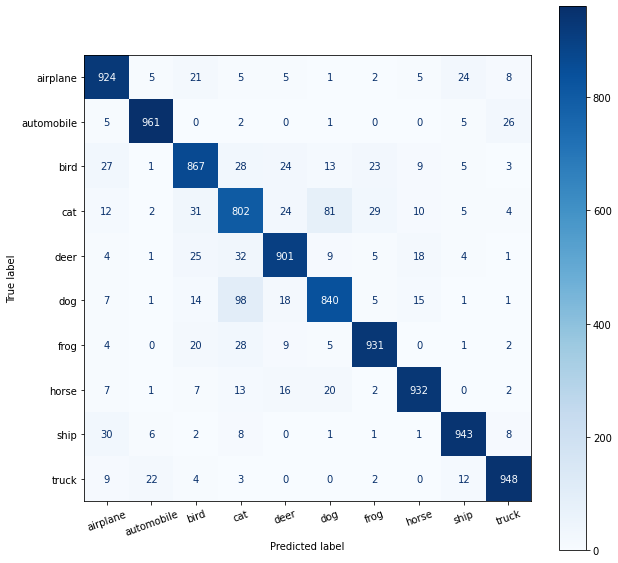


Finished! Accuracy: 90.72, Loss: 0.006302427011780674, Total time: 00:52:00.25.


In [15]:
model = 'vgg16_bn'
dataset_name = 'cifar10'
classifier = DeepClassifier(model, dataset_name, normalize=True)

optimizer='SGD'
momentum = 0.9
start_lr = 0.01
batch_size = 32
classifier.execute(log_dir=f'final/{model}', epochs=40, learning_rate=start_lr, batch_size=batch_size, optimizer_name=optimizer, normalize=True, momentum=momentum)

## **TRAIN and RESULT GoogLeNet**


1.  ### MNIST








Loading dataset ...


Initiating dataloaders ...

train dataset: [42000,28,28]
val dataset: [18000,28,28]
test dataset: [10000,28,28]

Log path: /content/drive/MyDrive/CW3/results/final/google_net/1620829341.335861_mnist_Adam_32_0.0001_0_0

2021-05-12-14:22:21, model: google_net, dataset: mnist, optimizer: Adam, epochs: 10, batch_size: 32, starting learning_rate: 0.0001, momentum: 0


Input Samples:



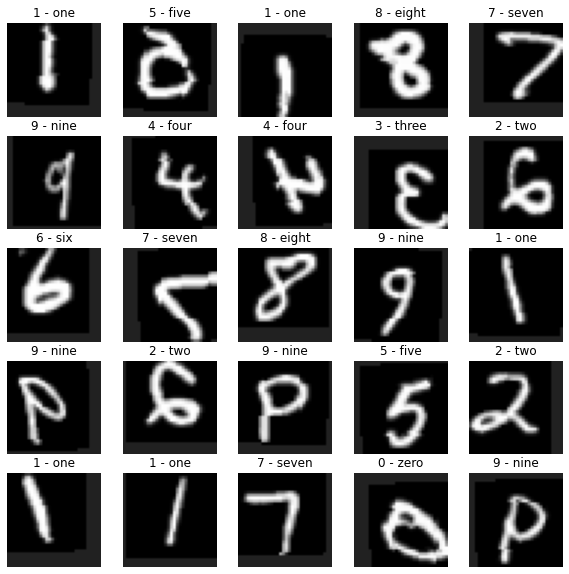


Input samples with filters applied from the first layer:



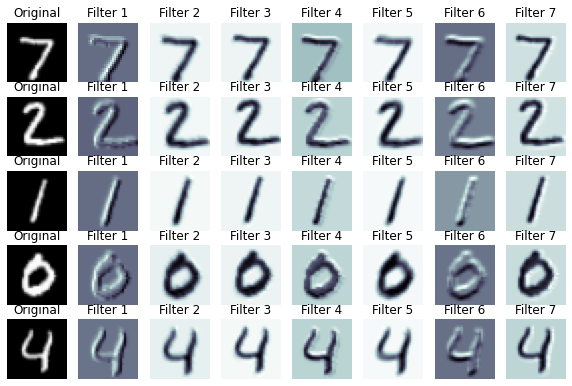


First layer filters visualization:



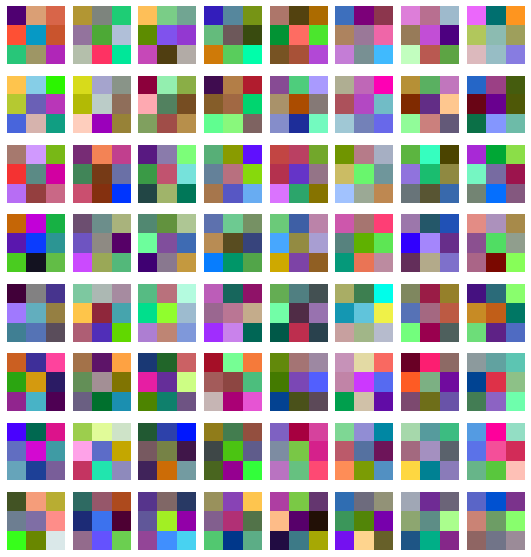

  0%|          | 0/10 [00:00<?, ?it/s]

 10%|█         | 1/10 [01:26<12:58, 86.47s/it]

2021-05-12-14:23:51 Epoch: 1
 lr: 0.0001, train_loss: 0.029318, train_acc: 75.60, val_loss: 0.008721, val_acc: 93.61, epoch_time: 86.47


 20%|██        | 2/10 [02:52<11:30, 86.37s/it]

2021-05-12-14:25:18 Epoch: 2
 lr: 0.0001, train_loss: 0.007059, train_acc: 94.45, val_loss: 0.004389, val_acc: 96.22, epoch_time: 86.12


 30%|███       | 3/10 [04:17<10:02, 86.08s/it]

2021-05-12-14:26:43 Epoch: 3
 lr: 0.0001, train_loss: 0.004405, train_acc: 96.15, val_loss: 0.003112, val_acc: 97.11, epoch_time: 85.40


 40%|████      | 4/10 [05:43<08:34, 85.80s/it]

2021-05-12-14:28:08 Epoch: 4
 lr: 0.0001, train_loss: 0.003423, train_acc: 96.87, val_loss: 0.002603, val_acc: 97.52, epoch_time: 85.16


 50%|█████     | 5/10 [07:08<07:08, 85.70s/it]

2021-05-12-14:29:34 Epoch: 5
 lr: 0.0001, train_loss: 0.002790, train_acc: 97.45, val_loss: 0.002484, val_acc: 97.60, epoch_time: 85.44


 60%|██████    | 6/10 [08:34<05:42, 85.72s/it]

2021-05-12-14:30:59 Epoch: 6
 lr: 0.0001, train_loss: 0.002441, train_acc: 97.70, val_loss: 0.002123, val_acc: 97.97, epoch_time: 85.79


 70%|███████   | 7/10 [10:01<04:18, 86.06s/it]

2021-05-12-14:32:26 Epoch: 7
 lr: 0.0001, train_loss: 0.002171, train_acc: 97.96, val_loss: 0.002119, val_acc: 97.93, epoch_time: 86.86


 80%|████████  | 8/10 [11:27<02:52, 86.15s/it]

2021-05-12-14:33:53 Epoch: 8
 lr: 0.0001, train_loss: 0.002025, train_acc: 97.97, val_loss: 0.002025, val_acc: 97.94, epoch_time: 86.36


 90%|█████████ | 9/10 [12:52<01:25, 85.89s/it]

2021-05-12-14:35:18 Epoch: 9
 lr: 0.0001, train_loss: 0.001861, train_acc: 98.25, val_loss: 0.001990, val_acc: 98.10, epoch_time: 85.27


2021-05-12-14:36:43 Epoch: 10
 lr: 0.0001, train_loss: 0.001699, train_acc: 98.30, val_loss: 0.001779, val_acc: 98.19, epoch_time: 85.23



Confusion Martix:



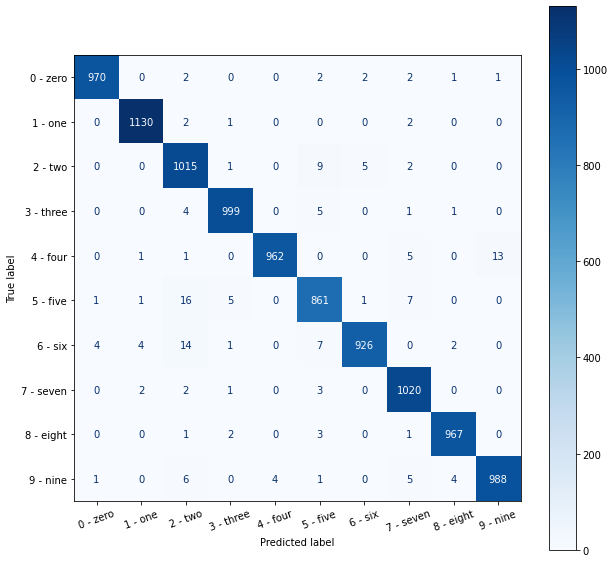


Finished! Accuracy: 98.38, Loss: 0.0015439845257089473, Total time: 00:14:18.12.


In [ ]:
model = 'google_net'
dataset_name = 'mnist'
classifier = DeepClassifier(model, dataset_name, normalize=True)

optimizer='Adam'
start_lr = 0.0001
batch_size = 32
weight_decay = 1e-4
classifier.execute(log_dir=f'final/{model}', epochs=10, learning_rate=start_lr, batch_size=batch_size, optimizer_name=optimizer, weight_decay=weight_decay, normalize=True)

2.  ### Fashion MNIST





Loading dataset ...


Initiating dataloaders ...

train dataset: [42000,28,28]
val dataset: [18000,28,28]
test dataset: [10000,28,28]

Log path: /content/drive/MyDrive/CW3/results/final/google_net/1620926755.574447_fmnist_Adam_32_0.0001_0_0.0001

2021-05-13-17:25:55, model: google_net, dataset: fmnist, optimizer: Adam, epochs: 20, batch_size: 32, starting learning_rate: 0.0001, momentum: 0, weight decay: 0.0001


Input Samples:



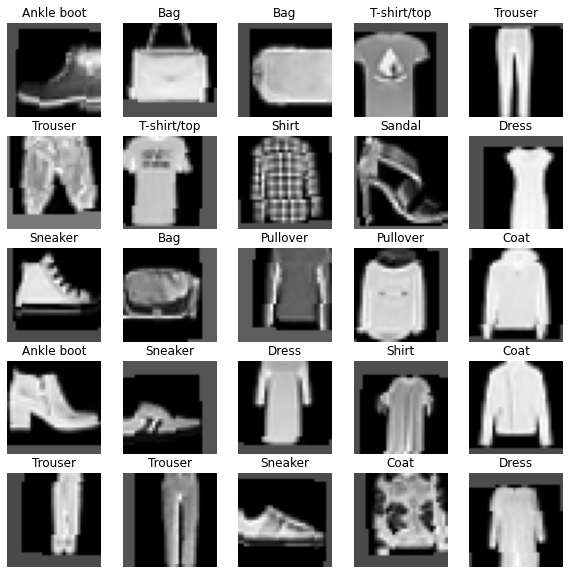


Input samples with filters applied from the first layer:



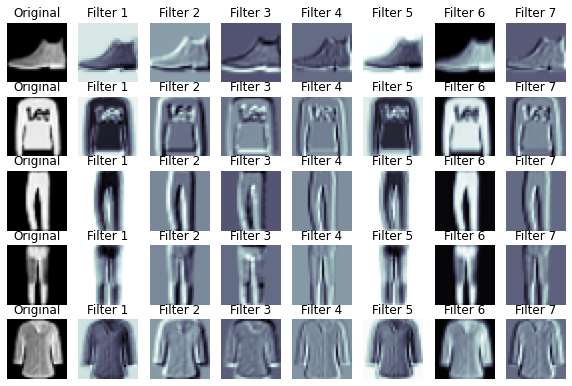


First layer filters visualization:



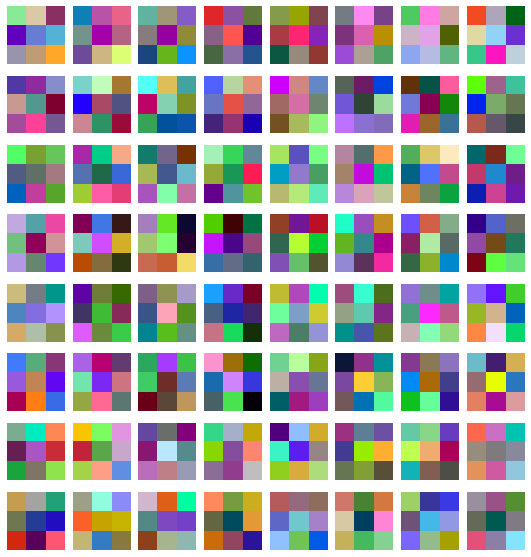

  0%|          | 0/20 [00:00<?, ?it/s]

  5%|▌         | 1/20 [01:40<31:43, 100.16s/it]

2021-05-13-17:27:40 Epoch: 1
 lr: 0.0001, train_loss: 0.032572, train_acc: 67.00, val_loss: 0.018352, val_acc: 78.88, epoch_time: 100.16


 10%|█         | 2/20 [03:21<30:08, 100.46s/it]

2021-05-13-17:29:21 Epoch: 2
 lr: 0.0001, train_loss: 0.017670, train_acc: 79.80, val_loss: 0.014298, val_acc: 83.11, epoch_time: 101.16


 15%|█▌        | 3/20 [05:01<28:25, 100.30s/it]

2021-05-13-17:31:01 Epoch: 3
 lr: 0.0001, train_loss: 0.014680, train_acc: 83.26, val_loss: 0.012569, val_acc: 85.33, epoch_time: 99.92


 20%|██        | 4/20 [06:40<26:41, 100.09s/it]

2021-05-13-17:32:41 Epoch: 4
 lr: 0.0001, train_loss: 0.013191, train_acc: 84.75, val_loss: 0.011519, val_acc: 86.68, epoch_time: 99.59


 25%|██▌       | 5/20 [08:20<24:59, 99.97s/it] 

2021-05-13-17:34:21 Epoch: 5
 lr: 0.0001, train_loss: 0.012022, train_acc: 86.29, val_loss: 0.010908, val_acc: 87.24, epoch_time: 99.70


 30%|███       | 6/20 [10:00<23:19, 99.97s/it]

2021-05-13-17:36:00 Epoch: 6
 lr: 0.0001, train_loss: 0.011318, train_acc: 87.03, val_loss: 0.010253, val_acc: 87.93, epoch_time: 99.95


 35%|███▌      | 7/20 [11:40<21:41, 100.08s/it]

2021-05-13-17:37:41 Epoch: 7
 lr: 0.0001, train_loss: 0.010587, train_acc: 87.86, val_loss: 0.009876, val_acc: 88.37, epoch_time: 100.34


 40%|████      | 8/20 [13:20<20:00, 100.02s/it]

2021-05-13-17:39:21 Epoch: 8
 lr: 0.0001, train_loss: 0.010295, train_acc: 88.14, val_loss: 0.009802, val_acc: 88.71, epoch_time: 99.87


 45%|████▌     | 9/20 [15:00<18:19, 99.94s/it] 

2021-05-13-17:41:00 Epoch: 9
 lr: 0.0001, train_loss: 0.009781, train_acc: 88.92, val_loss: 0.009558, val_acc: 88.99, epoch_time: 99.75


 50%|█████     | 10/20 [16:45<16:55, 101.56s/it]

2021-05-13-17:42:46 Epoch: 10
 lr: 0.0001, train_loss: 0.009339, train_acc: 89.26, val_loss: 0.009073, val_acc: 89.46, epoch_time: 105.34


 55%|█████▌    | 11/20 [18:29<15:21, 102.34s/it]

2021-05-13-17:44:30 Epoch: 11
 lr: 0.0001, train_loss: 0.009171, train_acc: 89.64, val_loss: 0.009051, val_acc: 89.83, epoch_time: 104.14


 60%|██████    | 12/20 [20:11<13:36, 102.02s/it]

2021-05-13-17:46:11 Epoch: 12
 lr: 0.0001, train_loss: 0.008836, train_acc: 89.79, val_loss: 0.008819, val_acc: 89.89, epoch_time: 101.28


 65%|██████▌   | 13/20 [21:53<11:54, 102.11s/it]

2021-05-13-17:47:54 Epoch: 13
 lr: 0.0001, train_loss: 0.008617, train_acc: 90.09, val_loss: 0.008734, val_acc: 90.10, epoch_time: 102.32


 70%|███████   | 14/20 [23:35<10:13, 102.17s/it]

2021-05-13-17:49:36 Epoch: 14
 lr: 0.0001, train_loss: 0.008452, train_acc: 90.34, val_loss: 0.008701, val_acc: 89.90, epoch_time: 102.31


 75%|███████▌  | 15/20 [25:18<08:30, 102.18s/it]

2021-05-13-17:51:18 Epoch: 15
 lr: 0.0001, train_loss: 0.008156, train_acc: 90.63, val_loss: 0.008608, val_acc: 90.27, epoch_time: 102.18


 80%|████████  | 16/20 [27:00<06:48, 102.23s/it]

2021-05-13-17:53:00 Epoch: 16
 lr: 0.0001, train_loss: 0.008060, train_acc: 90.70, val_loss: 0.008310, val_acc: 90.39, epoch_time: 102.35


 85%|████████▌ | 17/20 [28:42<05:06, 102.21s/it]

2021-05-13-17:54:43 Epoch: 17
 lr: 0.0001, train_loss: 0.007794, train_acc: 90.91, val_loss: 0.008419, val_acc: 90.38, epoch_time: 102.15


 90%|█████████ | 18/20 [30:24<03:24, 102.20s/it]

2021-05-13-17:56:25 Epoch: 18
 lr: 0.0001, train_loss: 0.007784, train_acc: 90.88, val_loss: 0.008232, val_acc: 90.59, epoch_time: 102.18


 95%|█████████▌| 19/20 [32:05<01:41, 101.82s/it]

2021-05-13-17:58:06 Epoch: 19
 lr: 0.0001, train_loss: 0.007539, train_acc: 91.28, val_loss: 0.007938, val_acc: 90.79, epoch_time: 100.92


2021-05-13-17:59:47 Epoch: 20
 lr: 0.0001, train_loss: 0.007386, train_acc: 91.44, val_loss: 0.007898, val_acc: 90.74, epoch_time: 101.33



Confusion Martix:



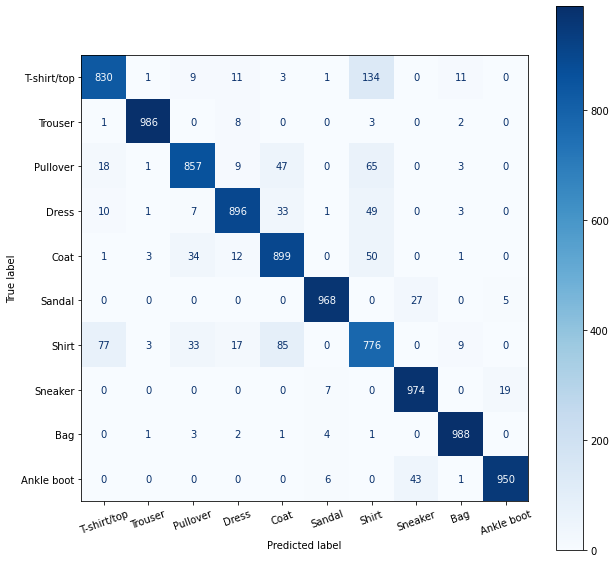


Finished! Accuracy: 91.24, Loss: 0.007998556121811272, Total time: 00:33:47.01.


In [ ]:
model = 'google_net'
dataset_name = 'fmnist'
classifier = DeepClassifier(model, dataset_name, normalize=True)

optimizer='Adam'
start_lr = 0.0001
batch_size = 32
weight_decay = 1e-4
classifier.execute(log_dir=f'final/{model}', epochs=20, learning_rate=start_lr, batch_size=batch_size, optimizer_name=optimizer, weight_decay=weight_decay, normalize=True)

3.  ### CIFAR10





Loading dataset ...

Files already downloaded and verified
Files already downloaded and verified

Initiating dataloaders ...

train dataset: [35000,32,32,3]
val dataset: [15000,32,32,3]
test dataset: [10000,32,32,3]

Log path: /content/drive/MyDrive/CW3/results/final/google_net/1620843517.013052_cifar10_Adam_32_0.01_0_0

2021-05-12-18:18:37, model: google_net, dataset: cifar10, optimizer: Adam, epochs: 40, batch_size: 32, starting learning_rate: 0.01, momentum: 0


Input Samples:



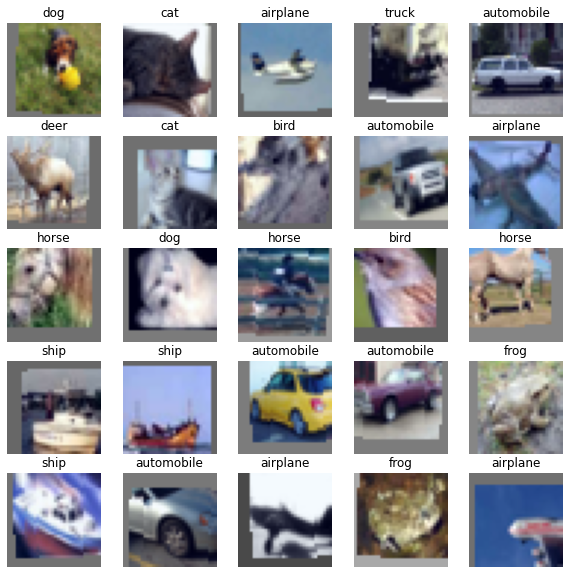


Input samples with filters applied from the first layer:



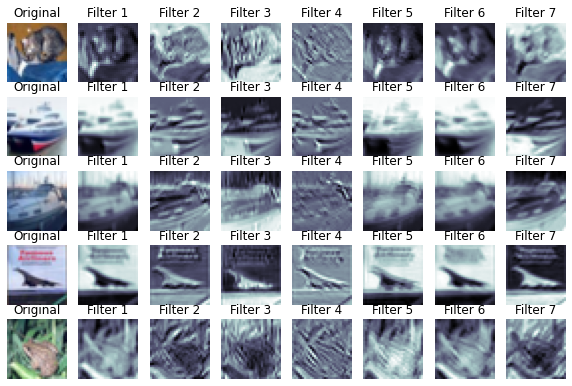


First layer filters visualization:



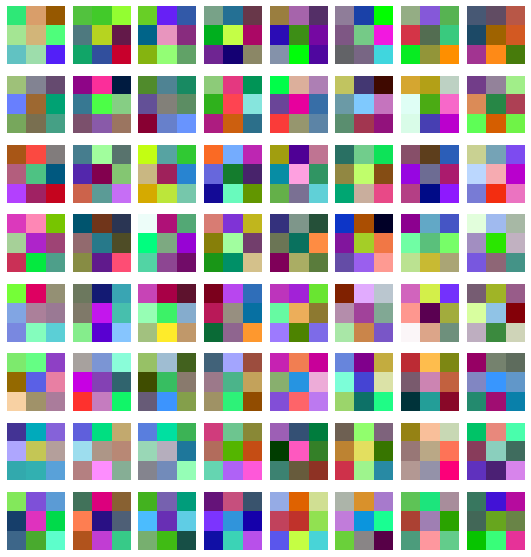


  0%|          | 0/40 [00:00<?, ?it/s]


  2%|▎         | 1/40 [01:46<1:09:00, 106.17s/it]

2021-05-12-18:20:29 Epoch: 1
 lr: 0.01, train_loss: 0.049561, train_acc: 39.92, val_loss: 0.046696, val_acc: 46.52, epoch_time: 106.17



  5%|▌         | 2/40 [03:32<1:07:17, 106.25s/it]

2021-05-12-18:22:16 Epoch: 2
 lr: 0.01, train_loss: 0.035798, train_acc: 58.68, val_loss: 0.032030, val_acc: 63.73, epoch_time: 106.42



  8%|▊         | 3/40 [05:17<1:05:18, 105.90s/it]

2021-05-12-18:24:01 Epoch: 3
 lr: 0.01, train_loss: 0.029613, train_acc: 66.59, val_loss: 0.026802, val_acc: 69.45, epoch_time: 105.07



 10%|█         | 4/40 [07:03<1:03:26, 105.73s/it]

2021-05-12-18:25:46 Epoch: 4
 lr: 0.01, train_loss: 0.026099, train_acc: 70.89, val_loss: 0.030441, val_acc: 66.37, epoch_time: 105.32



 12%|█▎        | 5/40 [08:48<1:01:34, 105.57s/it]

2021-05-12-18:27:31 Epoch: 5
 lr: 0.01, train_loss: 0.023838, train_acc: 73.42, val_loss: 0.030141, val_acc: 66.35, epoch_time: 105.18



 15%|█▌        | 6/40 [10:33<59:45, 105.46s/it]  

2021-05-12-18:29:16 Epoch: 6
 lr: 0.01, train_loss: 0.022095, train_acc: 75.36, val_loss: 0.023726, val_acc: 73.93, epoch_time: 105.18



 18%|█▊        | 7/40 [12:18<57:59, 105.45s/it]

2021-05-12-18:31:02 Epoch: 7
 lr: 0.01, train_loss: 0.020886, train_acc: 76.55, val_loss: 0.021580, val_acc: 76.72, epoch_time: 105.41



 20%|██        | 8/40 [14:04<56:18, 105.58s/it]

2021-05-12-18:32:48 Epoch: 8
 lr: 0.01, train_loss: 0.019776, train_acc: 77.78, val_loss: 0.020538, val_acc: 77.33, epoch_time: 105.86



 22%|██▎       | 9/40 [15:50<54:35, 105.65s/it]

2021-05-12-18:34:33 Epoch: 9
 lr: 0.01, train_loss: 0.018761, train_acc: 79.23, val_loss: 0.018997, val_acc: 79.10, epoch_time: 105.79



 25%|██▌       | 10/40 [17:36<52:49, 105.66s/it]

2021-05-12-18:36:19 Epoch: 10
 lr: 0.01, train_loss: 0.018019, train_acc: 80.00, val_loss: 0.020523, val_acc: 77.45, epoch_time: 105.67



 28%|██▊       | 11/40 [19:22<51:05, 105.71s/it]

2021-05-12-18:38:05 Epoch: 11
 lr: 0.01, train_loss: 0.017257, train_acc: 81.02, val_loss: 0.018949, val_acc: 79.53, epoch_time: 105.83



 30%|███       | 12/40 [21:07<49:21, 105.75s/it]

2021-05-12-18:39:51 Epoch: 12
 lr: 0.01, train_loss: 0.016579, train_acc: 81.45, val_loss: 0.019604, val_acc: 78.28, epoch_time: 105.82



 32%|███▎      | 13/40 [22:53<47:35, 105.75s/it]

2021-05-12-18:41:37 Epoch: 13
 lr: 0.01, train_loss: 0.016006, train_acc: 82.24, val_loss: 0.017939, val_acc: 79.93, epoch_time: 105.73



 35%|███▌      | 14/40 [24:39<45:48, 105.70s/it]

2021-05-12-18:43:22 Epoch: 14
 lr: 0.01, train_loss: 0.015427, train_acc: 82.98, val_loss: 0.016236, val_acc: 82.08, epoch_time: 105.55



 38%|███▊      | 15/40 [26:24<43:59, 105.59s/it]

2021-05-12-18:45:07 Epoch: 15
 lr: 0.01, train_loss: 0.014707, train_acc: 83.68, val_loss: 0.019494, val_acc: 79.17, epoch_time: 105.32



 40%|████      | 16/40 [28:09<42:12, 105.54s/it]

2021-05-12-18:46:53 Epoch: 16
 lr: 0.01, train_loss: 0.014339, train_acc: 84.03, val_loss: 0.016503, val_acc: 82.00, epoch_time: 105.39



 42%|████▎     | 17/40 [29:54<40:20, 105.26s/it]

2021-05-12-18:48:37 Epoch: 17
 lr: 0.01, train_loss: 0.013896, train_acc: 84.56, val_loss: 0.015778, val_acc: 82.84, epoch_time: 104.59



 45%|████▌     | 18/40 [31:39<38:31, 105.08s/it]

2021-05-12-18:50:22 Epoch: 18
 lr: 0.01, train_loss: 0.013399, train_acc: 85.21, val_loss: 0.016483, val_acc: 82.41, epoch_time: 104.66



 48%|████▊     | 19/40 [33:23<36:43, 104.93s/it]

2021-05-12-18:52:07 Epoch: 19
 lr: 0.01, train_loss: 0.013154, train_acc: 85.29, val_loss: 0.015625, val_acc: 82.74, epoch_time: 104.57



 50%|█████     | 20/40 [35:08<34:57, 104.86s/it]

2021-05-12-18:53:51 Epoch: 20
 lr: 0.01, train_loss: 0.012756, train_acc: 85.72, val_loss: 0.015526, val_acc: 83.53, epoch_time: 104.69



 52%|█████▎    | 21/40 [36:53<33:12, 104.84s/it]

2021-05-12-18:55:36 Epoch: 21
 lr: 0.01, train_loss: 0.012482, train_acc: 86.17, val_loss: 0.015128, val_acc: 84.00, epoch_time: 104.78



 55%|█████▌    | 22/40 [38:38<31:26, 104.83s/it]

2021-05-12-18:57:21 Epoch: 22
 lr: 0.01, train_loss: 0.012109, train_acc: 86.55, val_loss: 0.014826, val_acc: 84.09, epoch_time: 104.78



 57%|█████▊    | 23/40 [40:22<29:41, 104.78s/it]

2021-05-12-18:59:06 Epoch: 23
 lr: 0.01, train_loss: 0.011967, train_acc: 86.63, val_loss: 0.014038, val_acc: 84.63, epoch_time: 104.64



 60%|██████    | 24/40 [42:07<27:56, 104.79s/it]

2021-05-12-19:00:51 Epoch: 24
 lr: 0.01, train_loss: 0.011700, train_acc: 86.78, val_loss: 0.014271, val_acc: 84.67, epoch_time: 104.82



 62%|██████▎   | 25/40 [43:51<26:09, 104.66s/it]

2021-05-12-19:02:35 Epoch: 25
 lr: 0.01, train_loss: 0.011316, train_acc: 87.13, val_loss: 0.016928, val_acc: 81.69, epoch_time: 104.33



 65%|██████▌   | 26/40 [45:36<24:25, 104.70s/it]

2021-05-12-19:04:20 Epoch: 26
 lr: 0.01, train_loss: 0.011068, train_acc: 87.94, val_loss: 0.014913, val_acc: 84.36, epoch_time: 104.78



 68%|██████▊   | 27/40 [47:21<22:42, 104.83s/it]

2021-05-12-19:06:05 Epoch: 27
 lr: 0.01, train_loss: 0.010882, train_acc: 87.93, val_loss: 0.014092, val_acc: 85.24, epoch_time: 105.10



 70%|███████   | 28/40 [49:08<21:04, 105.34s/it]

2021-05-12-19:07:51 Epoch: 28
 lr: 0.01, train_loss: 0.010549, train_acc: 88.33, val_loss: 0.014454, val_acc: 84.95, epoch_time: 106.53



 72%|███████▎  | 29/40 [50:54<19:20, 105.46s/it]

2021-05-12-19:09:37 Epoch: 29
 lr: 0.01, train_loss: 0.010341, train_acc: 88.47, val_loss: 0.015132, val_acc: 84.02, epoch_time: 105.73



 75%|███████▌  | 30/40 [52:41<17:41, 106.12s/it]

2021-05-12-19:11:25 Epoch: 30
 lr: 0.01, train_loss: 0.010104, train_acc: 88.86, val_loss: 0.014647, val_acc: 84.88, epoch_time: 107.64



 78%|███████▊  | 31/40 [54:28<15:55, 106.21s/it]

2021-05-12-19:13:11 Epoch: 31
 lr: 0.001, train_loss: 0.007694, train_acc: 91.31, val_loss: 0.011660, val_acc: 87.71, epoch_time: 106.42



 80%|████████  | 32/40 [56:16<14:14, 106.83s/it]

2021-05-12-19:14:59 Epoch: 32
 lr: 0.001, train_loss: 0.006966, train_acc: 92.22, val_loss: 0.011499, val_acc: 87.96, epoch_time: 108.25



 82%|████████▎ | 33/40 [58:03<12:27, 106.75s/it]

2021-05-12-19:16:46 Epoch: 33
 lr: 0.001, train_loss: 0.006618, train_acc: 92.50, val_loss: 0.011702, val_acc: 87.75, epoch_time: 106.57



 85%|████████▌ | 34/40 [59:50<10:41, 106.83s/it]

2021-05-12-19:18:33 Epoch: 34
 lr: 0.001, train_loss: 0.006406, train_acc: 92.89, val_loss: 0.011832, val_acc: 88.04, epoch_time: 107.00



 88%|████████▊ | 35/40 [1:01:36<08:53, 106.75s/it]

2021-05-12-19:20:20 Epoch: 35
 lr: 0.001, train_loss: 0.006216, train_acc: 93.16, val_loss: 0.011742, val_acc: 88.17, epoch_time: 106.52



 90%|█████████ | 36/40 [1:03:23<07:06, 106.70s/it]

2021-05-12-19:22:06 Epoch: 36
 lr: 0.001, train_loss: 0.006019, train_acc: 93.33, val_loss: 0.011834, val_acc: 88.21, epoch_time: 106.56



 92%|█████████▎| 37/40 [1:05:09<05:20, 106.69s/it]

2021-05-12-19:23:53 Epoch: 37
 lr: 0.001, train_loss: 0.006100, train_acc: 93.21, val_loss: 0.011657, val_acc: 88.37, epoch_time: 106.67



 95%|█████████▌| 38/40 [1:06:57<03:33, 106.85s/it]

2021-05-12-19:25:40 Epoch: 38
 lr: 0.001, train_loss: 0.005850, train_acc: 93.48, val_loss: 0.011797, val_acc: 88.27, epoch_time: 107.21



 98%|█████████▊| 39/40 [1:08:44<01:47, 107.14s/it]

2021-05-12-19:27:28 Epoch: 39
 lr: 0.001, train_loss: 0.005784, train_acc: 93.63, val_loss: 0.011678, val_acc: 88.15, epoch_time: 107.79



100%|██████████| 40/40 [1:10:33<00:00, 107.42s/it]
                                                  

2021-05-12-19:29:16 Epoch: 40
 lr: 0.001, train_loss: 0.005757, train_acc: 93.54, val_loss: 0.011760, val_acc: 88.19, epoch_time: 108.08

Confusion Martix:



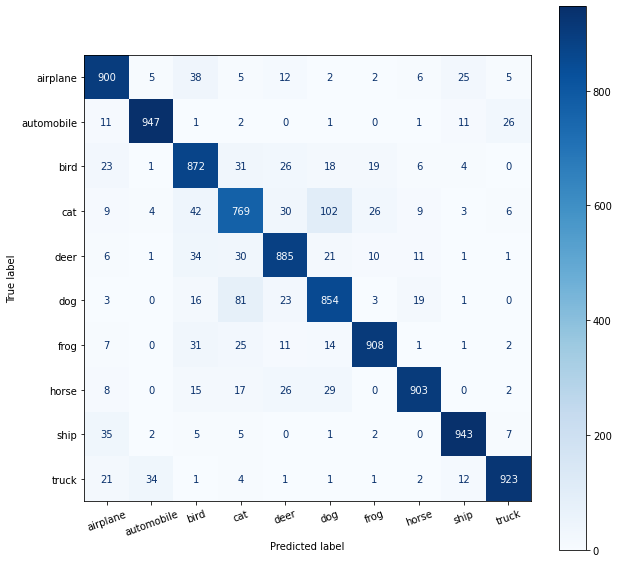


Finished! Accuracy: 89.04, Loss: 0.01215563420318067, Total time: 01:10:33.06.


In [ ]:
model = 'google_net'
dataset_name = 'cifar10'
classifier = DeepClassifier(model, dataset_name, normalize=True)

optimizer='Adam'
start_lr = 0.01
batch_size = 32
weight_decay = 1e-4
classifier.execute(log_dir=f'final/{model}', epochs=40, learning_rate=start_lr, batch_size=batch_size, optimizer_name=optimizer, weight_decay=weight_decay, normalize=True)

## **TRAIN and RESULT ResNet**



1.  ### MNIST








Loading dataset ...


Initiating dataloaders ...

train dataset: [42000,28,28]
val dataset: [18000,28,28]
test dataset: [10000,28,28]

Log path: /content/drive/MyDrive/CW3/results/final/resnet/1620837386.786471_mnist_SGD_32_0.01_0.9_0

2021-05-12-16:36:26, model: resnet, dataset: mnist, optimizer: SGD, epochs: 10, batch_size: 32, starting learning_rate: 0.01, momentum: 0.9


Input Samples:



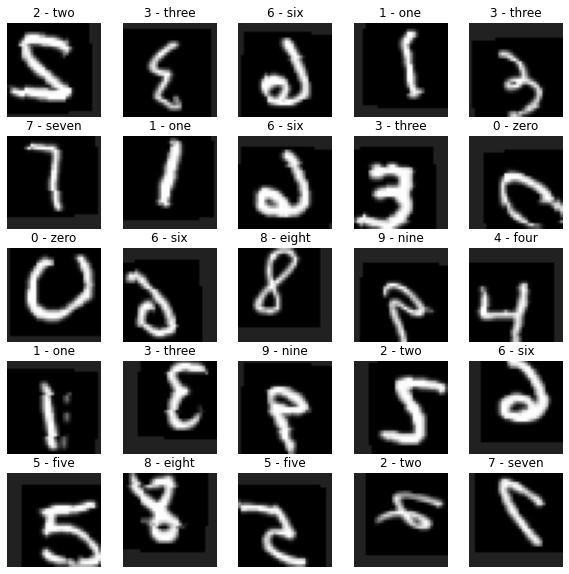


Input samples with filters applied from the first layer:



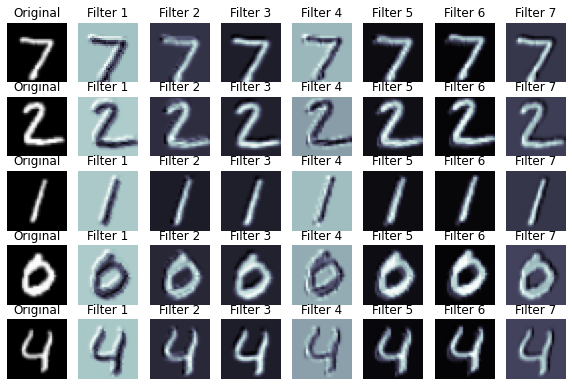


First layer filters visualization:



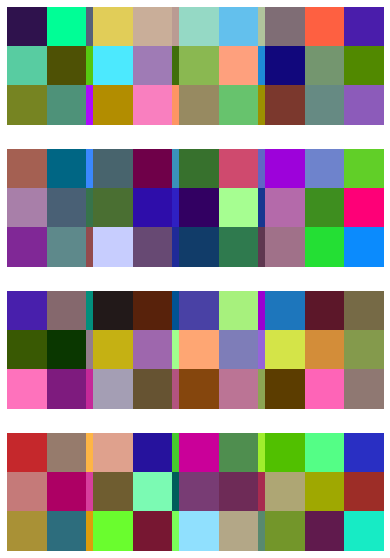

  0%|          | 0/10 [00:00<?, ?it/s]

 10%|█         | 1/10 [01:15<11:23, 75.98s/it]

2021-05-12-16:37:48 Epoch: 1
 lr: 0.01, train_loss: 0.014132, train_acc: 84.79, val_loss: 0.004715, val_acc: 95.61, epoch_time: 75.98


 20%|██        | 2/10 [02:32<10:09, 76.19s/it]

2021-05-12-16:39:05 Epoch: 2
 lr: 0.01, train_loss: 0.003966, train_acc: 96.15, val_loss: 0.002933, val_acc: 97.07, epoch_time: 76.66


 30%|███       | 3/10 [03:49<08:55, 76.45s/it]

2021-05-12-16:40:22 Epoch: 3
 lr: 0.01, train_loss: 0.003055, train_acc: 97.00, val_loss: 0.003102, val_acc: 96.79, epoch_time: 77.05


 40%|████      | 4/10 [05:06<07:39, 76.60s/it]

2021-05-12-16:41:39 Epoch: 4
 lr: 0.01, train_loss: 0.002515, train_acc: 97.45, val_loss: 0.002347, val_acc: 97.69, epoch_time: 76.94


 50%|█████     | 5/10 [06:23<06:22, 76.60s/it]

2021-05-12-16:42:55 Epoch: 5
 lr: 0.01, train_loss: 0.002279, train_acc: 97.69, val_loss: 0.001864, val_acc: 98.09, epoch_time: 76.61


 60%|██████    | 6/10 [07:40<05:06, 76.72s/it]

2021-05-12-16:44:12 Epoch: 6
 lr: 0.01, train_loss: 0.002022, train_acc: 97.96, val_loss: 0.001781, val_acc: 98.28, epoch_time: 76.99


 70%|███████   | 7/10 [08:56<03:50, 76.69s/it]

2021-05-12-16:45:29 Epoch: 7
 lr: 0.01, train_loss: 0.001879, train_acc: 98.09, val_loss: 0.002357, val_acc: 97.76, epoch_time: 76.61


 80%|████████  | 8/10 [10:13<02:33, 76.75s/it]

2021-05-12-16:46:46 Epoch: 8
 lr: 0.01, train_loss: 0.001830, train_acc: 98.12, val_loss: 0.001636, val_acc: 98.34, epoch_time: 76.89


 90%|█████████ | 9/10 [11:30<01:16, 76.82s/it]

2021-05-12-16:48:03 Epoch: 9
 lr: 0.01, train_loss: 0.001658, train_acc: 98.32, val_loss: 0.001963, val_acc: 98.11, epoch_time: 76.98


2021-05-12-16:49:20 Epoch: 10
 lr: 0.01, train_loss: 0.001581, train_acc: 98.37, val_loss: 0.001412, val_acc: 98.56, epoch_time: 76.77



Confusion Martix:



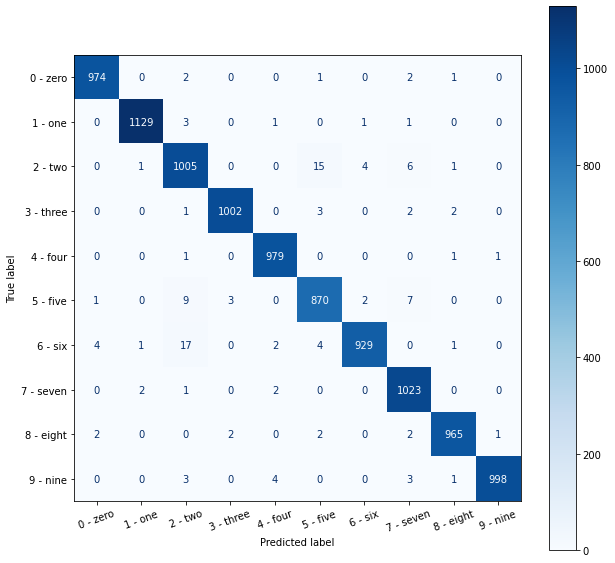


Finished! Accuracy: 98.74, Loss: 0.0012646178802911891, Total time: 00:12:47.52.


In [ ]:
model = 'resnet'
dataset_name = 'mnist'
classifier = DeepClassifier(model, dataset_name, normalize=True)

optimizer='SGD'
momentum = 0.9
start_lr = 0.01
batch_size = 32
classifier.execute(log_dir=f'final/{model}', epochs=10, learning_rate=start_lr, batch_size=batch_size, optimizer_name=optimizer, normalize=True, momentum=momentum)

2.  ### Fashion MNIST





Loading dataset ...


Initiating dataloaders ...

train dataset: [42000,28,28]
val dataset: [18000,28,28]
test dataset: [10000,28,28]

Log path: /content/drive/MyDrive/CW3/results/final/resnet/1620928920.835593_fmnist_SGD_32_0.01_0.9_0

2021-05-13-18:02:00, model: resnet, dataset: fmnist, optimizer: SGD, epochs: 20, batch_size: 32, starting learning_rate: 0.01, momentum: 0.9


Input Samples:



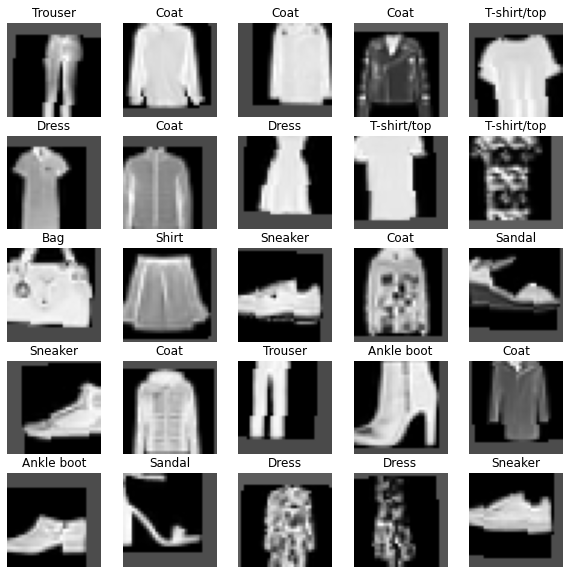


Input samples with filters applied from the first layer:



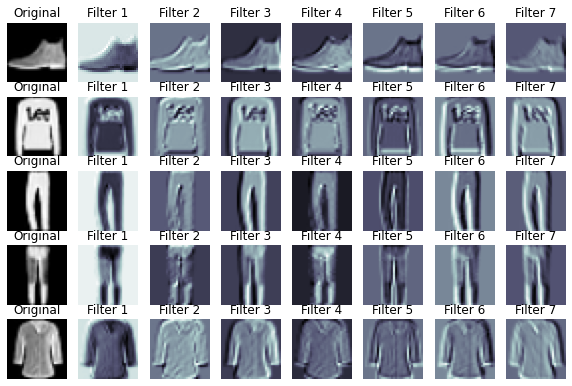


First layer filters visualization:



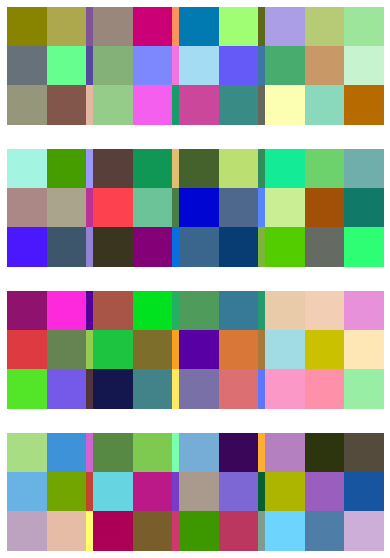

  0%|          | 0/20 [00:00<?, ?it/s]

  5%|▌         | 1/20 [01:03<20:00, 63.16s/it]

2021-05-13-18:03:07 Epoch: 1
 lr: 0.01, train_loss: 0.023338, train_acc: 72.05, val_loss: 0.016812, val_acc: 80.19, epoch_time: 63.16


 10%|█         | 2/20 [02:06<18:56, 63.17s/it]

2021-05-13-18:04:10 Epoch: 2
 lr: 0.01, train_loss: 0.014282, train_acc: 83.38, val_loss: 0.012284, val_acc: 85.49, epoch_time: 63.17


 15%|█▌        | 3/20 [03:09<17:52, 63.08s/it]

2021-05-13-18:05:13 Epoch: 3
 lr: 0.01, train_loss: 0.012308, train_acc: 85.74, val_loss: 0.012058, val_acc: 86.19, epoch_time: 62.86


 20%|██        | 4/20 [04:12<16:48, 63.01s/it]

2021-05-13-18:06:16 Epoch: 4
 lr: 0.01, train_loss: 0.011231, train_acc: 87.02, val_loss: 0.009953, val_acc: 88.36, epoch_time: 62.84


 25%|██▌       | 5/20 [05:14<15:44, 62.94s/it]

2021-05-13-18:07:19 Epoch: 5
 lr: 0.01, train_loss: 0.010208, train_acc: 88.23, val_loss: 0.010005, val_acc: 88.38, epoch_time: 62.78


 30%|███       | 6/20 [06:17<14:40, 62.86s/it]

2021-05-13-18:08:21 Epoch: 6
 lr: 0.01, train_loss: 0.009649, train_acc: 88.64, val_loss: 0.008929, val_acc: 89.84, epoch_time: 62.66


 35%|███▌      | 7/20 [07:20<13:36, 62.83s/it]

2021-05-13-18:09:24 Epoch: 7
 lr: 0.01, train_loss: 0.009241, train_acc: 89.11, val_loss: 0.008915, val_acc: 89.70, epoch_time: 62.76


 40%|████      | 8/20 [08:23<12:34, 62.84s/it]

2021-05-13-18:10:27 Epoch: 8
 lr: 0.01, train_loss: 0.008886, train_acc: 89.66, val_loss: 0.009351, val_acc: 89.18, epoch_time: 62.85


 45%|████▌     | 9/20 [09:26<11:32, 62.99s/it]

2021-05-13-18:11:30 Epoch: 9
 lr: 0.01, train_loss: 0.008550, train_acc: 90.07, val_loss: 0.009048, val_acc: 89.13, epoch_time: 63.36


 50%|█████     | 10/20 [10:29<10:30, 63.04s/it]

2021-05-13-18:12:34 Epoch: 10
 lr: 0.001, train_loss: 0.007392, train_acc: 91.41, val_loss: 0.007226, val_acc: 91.58, epoch_time: 63.16


 55%|█████▌    | 11/20 [11:32<09:27, 63.10s/it]

2021-05-13-18:13:37 Epoch: 11
 lr: 0.001, train_loss: 0.007110, train_acc: 91.69, val_loss: 0.007012, val_acc: 91.83, epoch_time: 63.22


 60%|██████    | 12/20 [12:33<08:17, 62.24s/it]

2021-05-13-18:14:37 Epoch: 12
 lr: 0.001, train_loss: 0.006879, train_acc: 92.12, val_loss: 0.006978, val_acc: 91.87, epoch_time: 60.24


 65%|██████▌   | 13/20 [13:32<07:10, 61.50s/it]

2021-05-13-18:15:37 Epoch: 13
 lr: 0.001, train_loss: 0.006846, train_acc: 91.98, val_loss: 0.007027, val_acc: 92.02, epoch_time: 59.77


 70%|███████   | 14/20 [14:32<06:05, 60.92s/it]

2021-05-13-18:16:36 Epoch: 14
 lr: 0.001, train_loss: 0.006765, train_acc: 92.15, val_loss: 0.007007, val_acc: 91.94, epoch_time: 59.56


 75%|███████▌  | 15/20 [15:31<05:02, 60.47s/it]

2021-05-13-18:17:36 Epoch: 15
 lr: 0.001, train_loss: 0.006753, train_acc: 92.22, val_loss: 0.006984, val_acc: 91.86, epoch_time: 59.41


 80%|████████  | 16/20 [16:31<04:00, 60.24s/it]

2021-05-13-18:18:36 Epoch: 16
 lr: 0.001, train_loss: 0.006693, train_acc: 92.18, val_loss: 0.006841, val_acc: 92.06, epoch_time: 59.71


 85%|████████▌ | 17/20 [17:31<03:00, 60.13s/it]

2021-05-13-18:19:35 Epoch: 17
 lr: 0.001, train_loss: 0.006548, train_acc: 92.18, val_loss: 0.006811, val_acc: 92.08, epoch_time: 59.88


 90%|█████████ | 18/20 [18:30<01:59, 59.95s/it]

2021-05-13-18:20:35 Epoch: 18
 lr: 0.001, train_loss: 0.006496, train_acc: 92.33, val_loss: 0.006869, val_acc: 92.22, epoch_time: 59.51


 95%|█████████▌| 19/20 [19:30<00:59, 59.72s/it]

2021-05-13-18:21:34 Epoch: 19
 lr: 0.001, train_loss: 0.006513, train_acc: 92.46, val_loss: 0.006757, val_acc: 92.23, epoch_time: 59.20


2021-05-13-18:22:34 Epoch: 20
 lr: 0.001, train_loss: 0.006495, train_acc: 92.40, val_loss: 0.006687, val_acc: 92.22, epoch_time: 59.41



Confusion Martix:



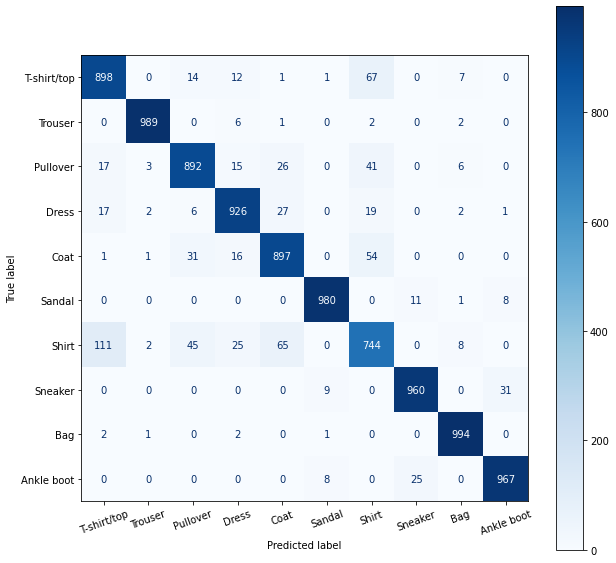


Finished! Accuracy: 92.47, Loss: 0.006703480082377792, Total time: 00:20:29.59.


In [ ]:
model = 'resnet'
dataset_name = 'fmnist'
classifier = DeepClassifier(model, dataset_name, normalize=True)

optimizer='SGD'
momentum = 0.9
start_lr = 0.01
batch_size = 32
classifier.execute(log_dir=f'final/{model}', epochs=20, learning_rate=start_lr, batch_size=batch_size, optimizer_name=optimizer, normalize=True, momentum=momentum)

3.  ### CIFAR10





Loading dataset ...

Files already downloaded and verified
Files already downloaded and verified

Initiating dataloaders ...

train dataset: [35000,32,32,3]
val dataset: [15000,32,32,3]
test dataset: [10000,32,32,3]
Log path: /content/drive/MyDrive/CW3/results/final/resnet/1620772328.726942_cifar10_SGD_32_0.01_0.9_0.0001

2021-05-11-22:32:08, model: resnet, dataset: cifar10, optimizer: SGD, epochs: 40, batch_size: 32, starting learning_rate: 0.01, momentum: 0.9, weight decay: 0.0001.


Input Samples:



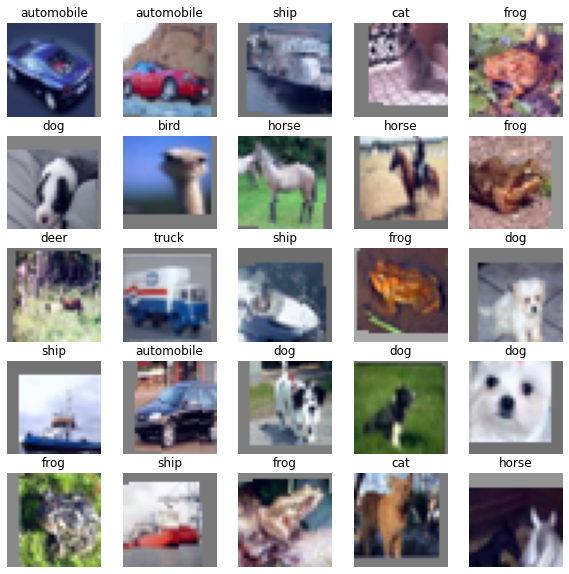


Input samples with filters applied from the first layer:



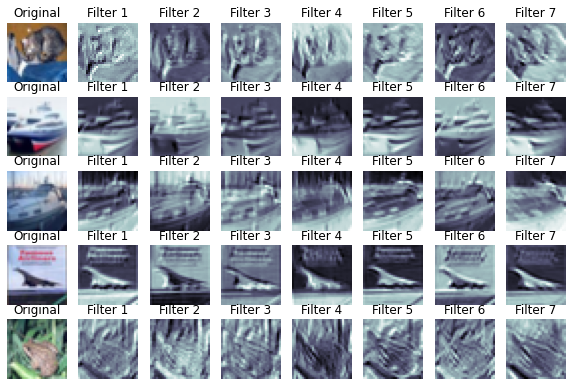


First layer filters visualization:



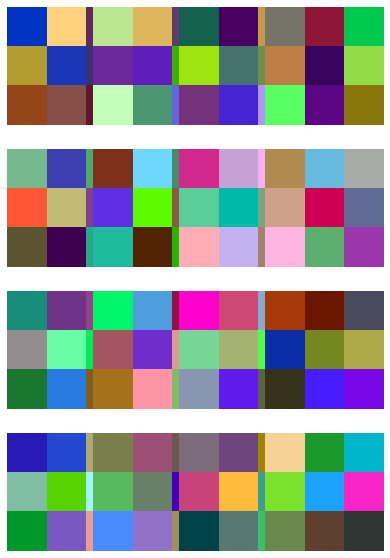


  0%|          | 0/40 [00:00<?, ?it/s]


  2%|▎         | 1/40 [00:45<29:45, 45.78s/it]

2021-05-11-22:32:57 Epoch: 1
 lr: 0.01, train_loss: 0.050539, train_acc: 39.25, val_loss: 0.044408, val_acc: 48.53, epoch_time: 45.77



  5%|▌         | 2/40 [01:31<28:59, 45.77s/it]

2021-05-11-22:33:43 Epoch: 2
 lr: 0.01, train_loss: 0.039170, train_acc: 54.76, val_loss: 0.040102, val_acc: 55.83, epoch_time: 45.74



  8%|▊         | 3/40 [02:17<28:14, 45.80s/it]

2021-05-11-22:34:29 Epoch: 3
 lr: 0.01, train_loss: 0.034101, train_acc: 61.08, val_loss: 0.035983, val_acc: 59.77, epoch_time: 45.87



 10%|█         | 4/40 [03:02<27:25, 45.72s/it]

2021-05-11-22:35:14 Epoch: 4
 lr: 0.01, train_loss: 0.030815, train_acc: 64.87, val_loss: 0.031052, val_acc: 65.19, epoch_time: 45.51



 12%|█▎        | 5/40 [03:48<26:41, 45.76s/it]

2021-05-11-22:36:00 Epoch: 5
 lr: 0.01, train_loss: 0.027956, train_acc: 68.49, val_loss: 0.028539, val_acc: 68.08, epoch_time: 45.83



 15%|█▌        | 6/40 [04:34<25:51, 45.65s/it]

2021-05-11-22:36:46 Epoch: 6
 lr: 0.01, train_loss: 0.025773, train_acc: 70.96, val_loss: 0.027217, val_acc: 70.13, epoch_time: 45.38



 18%|█▊        | 7/40 [05:19<25:06, 45.65s/it]

2021-05-11-22:37:31 Epoch: 7
 lr: 0.01, train_loss: 0.024325, train_acc: 73.01, val_loss: 0.024476, val_acc: 73.00, epoch_time: 45.64



 20%|██        | 8/40 [06:05<24:18, 45.57s/it]

2021-05-11-22:38:17 Epoch: 8
 lr: 0.01, train_loss: 0.022789, train_acc: 74.87, val_loss: 0.023581, val_acc: 73.88, epoch_time: 45.39



 22%|██▎       | 9/40 [06:50<23:31, 45.53s/it]

2021-05-11-22:39:02 Epoch: 9
 lr: 0.01, train_loss: 0.021854, train_acc: 75.78, val_loss: 0.022615, val_acc: 74.61, epoch_time: 45.41



 25%|██▌       | 10/40 [07:36<22:44, 45.50s/it]

2021-05-11-22:39:48 Epoch: 10
 lr: 0.01, train_loss: 0.020996, train_acc: 76.76, val_loss: 0.025794, val_acc: 72.39, epoch_time: 45.41



 28%|██▊       | 11/40 [08:21<21:59, 45.51s/it]

2021-05-11-22:40:33 Epoch: 11
 lr: 0.01, train_loss: 0.020119, train_acc: 77.79, val_loss: 0.021420, val_acc: 76.58, epoch_time: 45.52



 30%|███       | 12/40 [09:06<21:11, 45.42s/it]

2021-05-11-22:41:18 Epoch: 12
 lr: 0.01, train_loss: 0.019211, train_acc: 78.75, val_loss: 0.019939, val_acc: 77.59, epoch_time: 45.19



 32%|███▎      | 13/40 [09:52<20:26, 45.43s/it]

2021-05-11-22:42:04 Epoch: 13
 lr: 0.01, train_loss: 0.018632, train_acc: 79.27, val_loss: 0.020430, val_acc: 77.16, epoch_time: 45.44



 35%|███▌      | 14/40 [10:37<19:41, 45.44s/it]

2021-05-11-22:42:49 Epoch: 14
 lr: 0.01, train_loss: 0.017919, train_acc: 79.98, val_loss: 0.020514, val_acc: 77.46, epoch_time: 45.47



 38%|███▊      | 15/40 [11:23<18:55, 45.40s/it]

2021-05-11-22:43:35 Epoch: 15
 lr: 0.01, train_loss: 0.017452, train_acc: 80.83, val_loss: 0.019218, val_acc: 78.82, epoch_time: 45.30



 40%|████      | 16/40 [12:08<18:10, 45.45s/it]

2021-05-11-22:44:20 Epoch: 16
 lr: 0.01, train_loss: 0.016910, train_acc: 81.45, val_loss: 0.019227, val_acc: 78.44, epoch_time: 45.56



 42%|████▎     | 17/40 [12:54<17:25, 45.46s/it]

2021-05-11-22:45:06 Epoch: 17
 lr: 0.01, train_loss: 0.016576, train_acc: 81.54, val_loss: 0.018982, val_acc: 79.19, epoch_time: 45.48



 45%|████▌     | 18/40 [13:41<16:50, 45.91s/it]

2021-05-11-22:45:53 Epoch: 18
 lr: 0.01, train_loss: 0.015994, train_acc: 82.35, val_loss: 0.018839, val_acc: 79.11, epoch_time: 46.94



 48%|████▊     | 19/40 [14:26<16:03, 45.88s/it]

2021-05-11-22:46:38 Epoch: 19
 lr: 0.01, train_loss: 0.015659, train_acc: 82.91, val_loss: 0.017250, val_acc: 81.01, epoch_time: 45.81



 50%|█████     | 20/40 [15:12<15:14, 45.72s/it]

2021-05-11-22:47:24 Epoch: 20
 lr: 0.01, train_loss: 0.015410, train_acc: 82.75, val_loss: 0.017325, val_acc: 80.86, epoch_time: 45.33



 52%|█████▎    | 21/40 [15:57<14:25, 45.55s/it]

2021-05-11-22:48:09 Epoch: 21
 lr: 0.01, train_loss: 0.014922, train_acc: 83.49, val_loss: 0.017461, val_acc: 81.14, epoch_time: 45.15



 55%|█████▌    | 22/40 [16:42<13:38, 45.47s/it]

2021-05-11-22:48:54 Epoch: 22
 lr: 0.01, train_loss: 0.014526, train_acc: 83.87, val_loss: 0.016789, val_acc: 81.75, epoch_time: 45.27



 57%|█████▊    | 23/40 [17:27<12:51, 45.38s/it]

2021-05-11-22:49:39 Epoch: 23
 lr: 0.01, train_loss: 0.014307, train_acc: 84.01, val_loss: 0.017132, val_acc: 81.33, epoch_time: 45.17



 60%|██████    | 24/40 [18:12<12:04, 45.31s/it]

2021-05-11-22:50:24 Epoch: 24
 lr: 0.01, train_loss: 0.014047, train_acc: 84.33, val_loss: 0.017536, val_acc: 80.19, epoch_time: 45.12



 62%|██████▎   | 25/40 [18:58<11:18, 45.25s/it]

2021-05-11-22:51:10 Epoch: 25
 lr: 0.01, train_loss: 0.013923, train_acc: 84.45, val_loss: 0.015982, val_acc: 82.41, epoch_time: 45.10



 65%|██████▌   | 26/40 [19:43<10:32, 45.17s/it]

2021-05-11-22:51:55 Epoch: 26
 lr: 0.01, train_loss: 0.013310, train_acc: 85.30, val_loss: 0.017014, val_acc: 81.77, epoch_time: 45.00



 68%|██████▊   | 27/40 [20:28<09:46, 45.15s/it]

2021-05-11-22:52:40 Epoch: 27
 lr: 0.01, train_loss: 0.013083, train_acc: 85.43, val_loss: 0.017848, val_acc: 80.55, epoch_time: 45.10



 70%|███████   | 28/40 [21:13<09:02, 45.19s/it]

2021-05-11-22:53:25 Epoch: 28
 lr: 0.01, train_loss: 0.012989, train_acc: 85.50, val_loss: 0.017307, val_acc: 81.21, epoch_time: 45.26



 72%|███████▎  | 29/40 [21:58<08:16, 45.16s/it]

2021-05-11-22:54:10 Epoch: 29
 lr: 0.001, train_loss: 0.010418, train_acc: 88.67, val_loss: 0.013472, val_acc: 85.46, epoch_time: 45.09



 75%|███████▌  | 30/40 [22:44<07:32, 45.27s/it]

2021-05-11-22:54:56 Epoch: 30
 lr: 0.001, train_loss: 0.009728, train_acc: 89.35, val_loss: 0.013321, val_acc: 85.72, epoch_time: 45.50



 78%|███████▊  | 31/40 [23:29<06:47, 45.27s/it]

2021-05-11-22:55:41 Epoch: 31
 lr: 0.001, train_loss: 0.009563, train_acc: 89.32, val_loss: 0.013427, val_acc: 85.24, epoch_time: 45.28



 80%|████████  | 32/40 [24:15<06:03, 45.38s/it]

2021-05-11-22:56:26 Epoch: 32
 lr: 0.001, train_loss: 0.009204, train_acc: 89.76, val_loss: 0.013218, val_acc: 85.59, epoch_time: 45.63



 82%|████████▎ | 33/40 [25:00<05:17, 45.35s/it]

2021-05-11-22:57:12 Epoch: 33
 lr: 0.001, train_loss: 0.009074, train_acc: 89.96, val_loss: 0.013262, val_acc: 85.75, epoch_time: 45.27



 85%|████████▌ | 34/40 [25:45<04:32, 45.39s/it]

2021-05-11-22:57:57 Epoch: 34
 lr: 0.001, train_loss: 0.009033, train_acc: 89.88, val_loss: 0.013253, val_acc: 86.01, epoch_time: 45.47



 88%|████████▊ | 35/40 [26:30<03:46, 45.27s/it]

2021-05-11-22:58:42 Epoch: 35
 lr: 0.001, train_loss: 0.008875, train_acc: 90.22, val_loss: 0.013224, val_acc: 85.72, epoch_time: 44.98



 90%|█████████ | 36/40 [27:16<03:01, 45.27s/it]

2021-05-11-22:59:28 Epoch: 36
 lr: 0.001, train_loss: 0.008777, train_acc: 90.36, val_loss: 0.012983, val_acc: 85.93, epoch_time: 45.27



 92%|█████████▎| 37/40 [28:01<02:15, 45.23s/it]

2021-05-11-23:00:13 Epoch: 37
 lr: 0.001, train_loss: 0.008621, train_acc: 90.31, val_loss: 0.013031, val_acc: 85.95, epoch_time: 45.11



 95%|█████████▌| 38/40 [28:46<01:30, 45.20s/it]

2021-05-11-23:00:58 Epoch: 38
 lr: 0.0001, train_loss: 0.008385, train_acc: 90.56, val_loss: 0.013076, val_acc: 85.98, epoch_time: 45.12



 98%|█████████▊| 39/40 [29:31<00:45, 45.12s/it]

2021-05-11-23:01:43 Epoch: 39
 lr: 0.0001, train_loss: 0.008389, train_acc: 90.65, val_loss: 0.012779, val_acc: 86.07, epoch_time: 44.94



100%|██████████| 40/40 [30:16<00:00, 45.08s/it]
                                               

2021-05-11-23:02:28 Epoch: 40
 lr: 0.0001, train_loss: 0.008186, train_acc: 90.97, val_loss: 0.013015, val_acc: 86.09, epoch_time: 44.95

Confusion Martix:



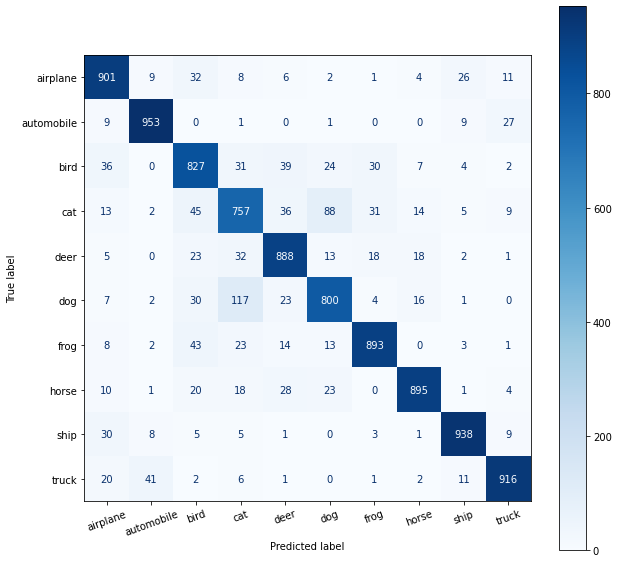


Finished! Accuracy: 87.68, Loss: 0.011902475026622415, Total time: 00:30:16.24.


In [ ]:
model = 'resnet'
dataset_name = 'cifar10'
classifier = DeepClassifier(model, dataset_name, normalize=True)

optimizer='SGD'
momentum = 0.9
start_lr = 0.01
batch_size = 32
weight_decay = 1e-4
classifier.execute(log_dir=f'finatl/{model}', epochs=40, learning_rate=start_lr, batch_size=batch_size, optimizer_name=optimizer, momentum=momentum, weight_decay=weight_decay)

In [27]:
%tensorboard --logdir /content/drive/MyDrive/CW3/results/final

<IPython.core.display.Javascript object>